# Visión por Computador - Práctica 1 - Filtrado de Imágenes

#### 12 puntos   |   Fecha de entrega: 03 de Noviembre, 23:59   |   Forma de entrega: a través de la tarea creada en https://pradogrado2425.ugr.es/

### Estudiante: <mark>Pablo Gálvez Ortigosa</mark>



---

## Normas de entrega

1. Para este trabajo, al igual que para los demás, se debe presentar código, resultados, discusión de los mismos, y presentación y análisis del trabajo realizado, todo integrado en el propio Google Colab Notebook (es decir, no se entrega ninguna memoria separada en `.pdf` ni ningún código `.py`). Se recuerda que código y resultados sin informe explicativo no puntúa.

2. En relación con el punto anterior, solo se acepta la entrega de ficheros `.ipynb` (no resulta válido entregar un fichero `.py`).

3. El diseño de celdas del documento debe ser respetado.

4. Solo se entregará el fichero `.ipynb` (incorporando código, resultados, y explicación del trabajo realizado y los resultados obtenidos) y no se enviarán las imágenes empleadas.

5. El path para la lectura de imágenes, o cualquier otro fichero de entrada, debe ser siempre “/content/drive/My Drive/images/nombre_fichero”

6. El código deberá  presentarse adecudamente comentado y con los resultados obtenidos en cada apartado, junto con la presentación del trabajo realizado y la discusión y análisis de los resultados obtenidos. Es importante reiterar que la entrega de código sin informe explicativo o valoraciones no puntúa. Por otro lado, el código debe ir comentado en comentarios en celdas de código, mientras que el análisis y discusión, tanto del trabajo realizado como de los resultados obtenidos, debe ir en celdas de texto.

Este trabajo de implementación tiene como objetivo principal **familiarizarse con la implementación y uso de filtros de convolución, así como del cálculo de las derivadas de una imagen y sus posibles aplicaciones**.








---



## Funciones de apoyo y conexión con Google Drive

In [2]:
# We start by getting access to the drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [3]:
# We import the modules to use
import os,sys
import cv2, numpy as np, math
from matplotlib import pyplot as plt
# change directory
%cd '/content/drive/My Drive'
#  the current directory
%pwd

# This allows to display images  and to save  them in cells
%matplotlib inline
# this definition allows to read files in a specific path
get_image = lambda route: os.path.join('/content/drive/My Drive/images', route)

/content/drive/My Drive


Las funciones que se incluyen a continuación, se proporcionan como ayuda/apoyo para el estudiante. **En caso de que el alumnado prefiera utilizar otras funciones para lectura, normalización y visualización de imágenes, tiene total libertad para hacerlo, pero sí debe justificar y explicar razonadamente el motivo de dicho cambio y describir las modificaciones realizadas.**

Recuérdese que todas las imágenes a emplear durante las prácticas de todo el curso se pueden encontrar en el enlace de Google Drive indicado en PRADO: https://pradogrado2425.ugr.es/mod/url/view.php?id=91457 En concreto, https://drive.google.com/drive/folders/1UtvY8q6w1Cz9a9T9zxIqSweoRLgNwoW-

In [4]:
'''
This function receives a string with the filename of the image to read,
and a flag indicating if we want to read it in color/RGB (flagColor=1) or gray level (flagColor=0)

Example of use:
im1=readIm(get_image('apple.jpg'),0)

'''
def readIm(filename, flagColor=1):
  # cv2 reads BGR format
  im=cv2.imread(filename)
  # change to  RGB and return the image
  if(flagColor):
    return cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
  # change from BGR to grayscale instead if flag is 0
  return cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)

In [5]:
'''
This function receives an array of arbitrary real numbers (that could include even negative values),
and returns an 'image' in the range [0,1].
flag_GLOBAL allows the user to normalize the whole image (including all channels) or to normalize
each channel/band independently.
'''
def rangeDisplay01(im, flag_GLOBAL= True):
  im = im.astype(float)
  if flag_GLOBAL:
    im = (im - im.min())/(im.max() - im.min())
  else:
    # bands normalization
    for band in range(im.shape[2]):
      im[:, :, band] = (im[:, :, band] - im[:, :, band].min())/(im[:, :, band].max() - im[:, :, band].min())
      # Note: remember that, for plt.imshow with RGB data, the valid range is [0..1] for floats and [0..255] for integers.
  return im

In [6]:
'''
This function displays a single image, including a title, using a magnification factor.

Example of use:
im1=readIm(get_image('apple.jpg'),0)
displayIm(im1,'Manzana',0.5)

'''
def displayIm(im, title='Result',factor= 2):
  # First normalize range
  max=np.max(im)
  min=np.min(im)
  if min<0 or max>255:
    im=rangeDisplay01(im,flag_GLOBAL=True)
  if len(im.shape) == 3:
    # im es tribanda
    plt.imshow(im, cmap='jet')
  else:
    # im es monobanda
    plt.imshow(im, cmap='gray')
  figure_size = plt.gcf().get_size_inches()
  plt.gcf().set_size_inches(factor * figure_size)
  plt.title(title)
  plt.xticks([]), plt.yticks([]) # eliminamos numeración
  plt.show()

In [7]:
'''
This function displays multiple images (including a title and using a magnification factor)
of equal size. The input to the function is a list of images.

Example of use:
im1=readIm(get_image('apple.jpg'),1)
images = [im1,im1,im1]

displayMI_ES(images, title='Manzanas',factor=1)

IMPORTANT NOTE: it is important to notice that this function stacks all images
and later call displayIm(). This implies that the normalization (rangeDisplay01()) is done
at the very end of the process. As a consequence, if the stacked images have different
range values they can be displayed in a "weird" way (with black regions (pixel value = 0)
looking grey). In case the visualization seems to be a problem, a possible solution
would be to create vim using vim.append(rangeDisplay01(...)). In this way, all images
would be on the same range of values (negative values around 0 (black),
0 values around 0.5 (grey), and positive values closer to 1 (white))

'''
def displayMI_ES(vim, title='Result',factor=2):
  # We set the maximun number of images to concatenate by columns
  maxcolumns=3
  # number of images to display
  numberim=len(vim)
  # The simplest case, one row: the maximum number of columns is larger than the images to stack
  # This is, by default, we put together the images column-wise
  if len(vim) < maxcolumns:
    out=vim[0]
    for item in range(1,len(vim)):
      #displayIm(out,str(item),1)
      out=np.hstack((out,vim[item]))

  # Else, if maxcolumns is smaller or equal than the number of images to stack
  else:
    # We check if all rows and columns are going to be 'busy', or if otherwise we need an extra-row
    if np.mod(len(vim),maxcolumns)== 0:
      maxrows=numberim//maxcolumns
    else:
      maxrows=numberim//maxcolumns+1

    # we build up the first block-row
    out=vim[0]
    for item in range(1,maxcolumns):
      out=np.hstack((out,vim[item]))
    # We build up the rest of block-rows
    for block in range(1,maxrows):
      #print(block)
      row=vim[block*maxcolumns]
      for item in range(1,maxcolumns):
        # We still have images to stack
        if block*maxcolumns+item < numberim:
          row=np.hstack((row,vim[block*maxcolumns+item]))
        # We do not have more images, and we have to fill with black
        else:
          row=np.hstack((row,np.zeros(vim[0].shape,dtype=vim[0].dtype)))
          #print(row.dtype)
          # if we don't include ',dtype=vim[0].dtype', np.zeros will include float
          # numbers in the matrix. This will make that the whole matrix will be
          # considered as floats, and values larger than 1 will be clipped to 1,
          # displaying an almost totally white image
      # add the new block-row
      out=np.vstack((out,row))
  return displayIm(out,title,factor)

# **Ejercicio 1: discretización de máscaras y filtrado Gaussiano** (6 puntos)

En este ejercicio aprenderemos a discretizar máscaras de convolución y a aplicarlas sobre imágenes empleando funciones de OpenCV. También buscamos hacerlo de un modo eficiente, y es por ello que, en toda la práctica, se exige el uso de convoluciones 1D (separables).





## A) (1.5 puntos)

<font color='blue'> En este apartado se deben realizar las siguientes tareas:

1. Calcular las máscaras discretas 1D de la Gaussiana, así como su primera y segunda derivadas (normalizadas), considerando que la entrada a dicha función de creación de máscaras 1D puede ser tanto un posible sigma como un posible tamaño de máscara.
2. Emplear los siguientes valores de sigma ($\{1, 1.5, 2.5, 6\}$) y los siguientes valores de tamaño de máscara ($\{7, 11, 15\}$), y mostrar el perfil (es decir, la silueta de las máscaras como funciones 1D) para verificar que las máscaras creadas son correctas.
3. Describir/explicar/analizar si las formas de dichos kernels tienen sentido y se corresponden con lo que esperaríamos ver.




Para facilitar el cálculo de las derivadas, utilizaremos una librería de cálculo simbólico como sympy. De esta forma, aseguraremos que las fórmulas obtenidas son correctas:

In [8]:
import sympy as sp

# Declaramos que x y sigma son símbolos
x, sigma = sp.symbols('x sigma')
gaussiana = sp.exp(-x**2 / (2*sigma**2))

# Gaussiana
print('Gaussiana:')
print(gaussiana)

# Derivada de la gaussiana
print('Primera derivada:')
print(sp.diff(gaussiana,x)) # Derivamos con respecto a x 1 vez

# Segunda derivada de la gaussiana
print('Segunda derivada:')
print(sp.diff(gaussiana,x,2)) # Derivamos con respecto a x 2 veces

Gaussiana:
exp(-x**2/(2*sigma**2))
Primera derivada:
-x*exp(-x**2/(2*sigma**2))/sigma**2
Segunda derivada:
(-1 + x**2/sigma**2)*exp(-x**2/(2*sigma**2))/sigma**2


In [9]:
# Eliminamos los símbolos declarados anteriormente
del x, sigma

Declaramos una función para la gaussiana, otra para su primera derivada y otra para su segunda (con las expresiones obtenidas anteriormente, en este caso en cálculo numérico):

In [10]:
def GaussFunc(x,sigma):
    return np.exp(-x**2 / (2*sigma**2))

def GaussDeriv1Func(x,sigma):
    return -x*np.exp(-x**2/(2*sigma**2))/sigma**2

def GaussDeriv2Func(x,sigma):
    return (-1 + x**2/sigma**2)*np.exp(-x**2/(2*sigma**2))/sigma**2

def gaussianMask1D(sigma=0, sizeMask=0, order=0):

  mask = []

  # f será la función que aplicaremos
  if order == 0:
    f = GaussFunc
  elif order == 1:
    f = GaussDeriv1Func
  elif order == 2:
    f = GaussDeriv2Func

  # Si nos proporcionan sigma
  if sigma != 0:
    # Truncamos 3*sigma
    k = int(3*sigma)
    # Si truncando no es >= 3*sigma, aumentamos k en 1
    if k < 3*sigma:
      k += 1
    sizeMask = 2*k+1

  # Si nos propocionan el tamaño
  elif sizeMask != 0:
    # Calculamos k
    k = int((sizeMask - 1) / 2)
    # Calculamos sigma
    sigma = k / 3

  for i in range(-k,k+1) :
    mask.append([i,f(i,sigma)])

  # order = 0 -> función Gaussiana
  # order = 1 -> derivada de la Gaussiana
  # order = 2 -> derivada segunda de la Gaussiana

  # Convertimos mask en un array de numpy
  mask = np.array(mask)

  # Se normaliza si no es la derivada
  if order == 0:
    mask[:,1] = mask[:,1] / np.sum(mask[:,1])
  else:
    mask[:,1] = mask[:,1] * (sigma**order)

  return mask, sigma, sizeMask

Aclaramos algunas cuestiones relativas a la anterior función $gaussianMask1D$.

La máscara que se devolverá será un array que en cada posición tendrá $[i,f(i)]$, con $i$ desde $-k$ hasta $k$. Esto se hace para facilitar la posterior visualización de la máscara.

Si conocemos $\sigma$, sabemos que $k$ será el primer entero que verifique $k \geq 3\cdot\sigma$. Como la máscara incluye los valores de $f$ desde $-k$ hasta $k$, incluyendo el 0, el tamaño de la máscara será $2\cdot k +1$.

Por otra parte, si solo conocemos el tamaño de la máscara, de la última expresión podemos encontrar cuál es el valor de $k$ (suponemos que el valor de tamaño que le llega a la función será impar). A partir de $k$, podemos calcular un posible valor de $\sigma$ dividiendo entre $3$ (en teoría, existen varios valores, ya que no es necesaria la igualdad, solo $k \geq 3$).

En el caso `order = 0` es necesaria la normalización, ya que no normalizar acabaría provocando una saturación (a blanco, o a negro, dependiendo de si la suma es mayor que 1 o menor).

Se ha normalizado la máscara únicamente en el caso `order=0`, ya que en el caso de la derivada, los coeficientes sumarán aproximadamente 0, y obtendríamos un vector con coeficientes muy elevados, o en el peor de los casos, NaN.

Los coeficientes sumarán 0 en el caso de la derivada, ya que si diferenciamos una imagen en la que todos los píxeles toman un valor concreto $r$, el resultado que esperamos es 0, ya que estamos diferenciando una función constante.

Para `order > 0` es necesario multiplicar la máscara obtenida por $\sigma^{order}$. Si no lo hacemos, los valores de la señal obtenida irían disminuyendo.

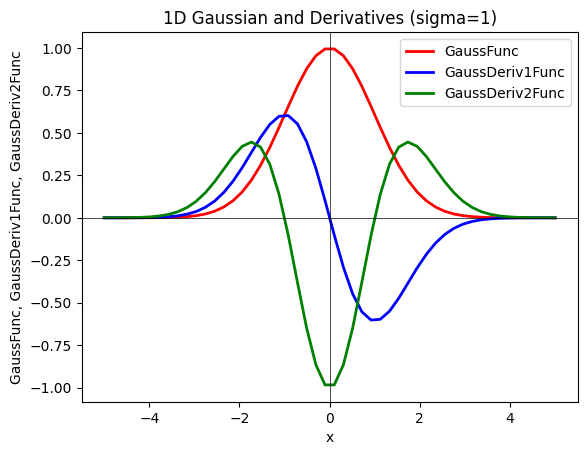

In [11]:
# Con la siguiente figura verificamos que las funciones Gaussianas implementadas son correctas
plt.figure()
xvalues = np.linspace(-5, 5)
yvalues1 = GaussFunc(xvalues,1)
yvalues2 = GaussDeriv1Func(xvalues,1)
yvalues3 = GaussDeriv2Func(xvalues,1)
plt.plot(xvalues, yvalues1, lw=2, color='red',
label='GaussFunc')
plt.plot(xvalues, yvalues2, lw=2, color='blue',
label='GaussDeriv1Func')
plt.plot(xvalues, yvalues3, lw=2, color='green',
label='GaussDeriv2Func')
plt.title('1D Gaussian and Derivatives (sigma=1)')
plt.xlabel('x')
plt.ylabel('GaussFunc, GaussDeriv1Func, GaussDeriv2Func')
plt.axhline(0, lw=0.5, color='black')
plt.axvline(0, lw=0.5, color='black')
plt.legend();

Los resultados parecen razonables:
- La gráfica de la gaussiana que hemos obtenido es igual a la que conocemos.
- Las gráficas de las derivadas son también razonables. La primera derivada muestra el crecimiento y decrecimiento de la gaussiana, mientras que la segunda muestra los cambios en la concavidad y convexidad. En las derivadas, se observan un mayor número de oscilaciones en comparación a la gaussiana sin derivar.

In [12]:
gaussianMask1D(sigma = 1, order = 1)

(array([[-3.        ,  0.03332699],
        [-2.        ,  0.27067057],
        [-1.        ,  0.60653066],
        [ 0.        ,  0.        ],
        [ 1.        , -0.60653066],
        [ 2.        , -0.27067057],
        [ 3.        , -0.03332699]]),
 1,
 7)

Mostramos ahora las máscaras obtenidas fijando primero distintos tamaños, y después fijando varios valores de sigma.





FIJAMOS PRIMERO EL TAMAÑO DE LA MÁSCARA


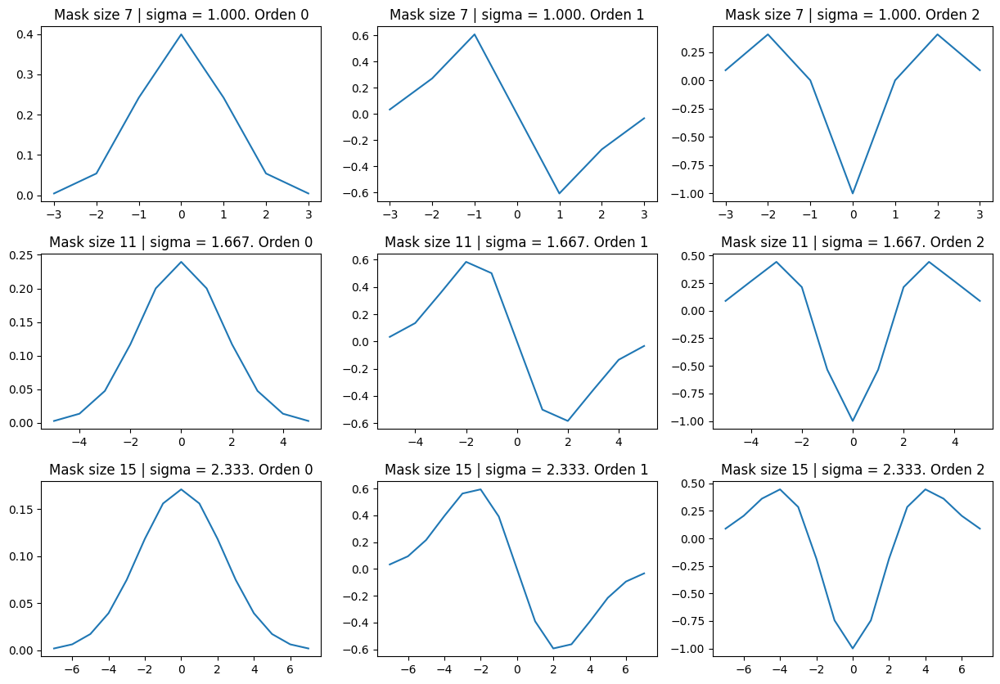

FIJAMOS AHORA EL SIGMA


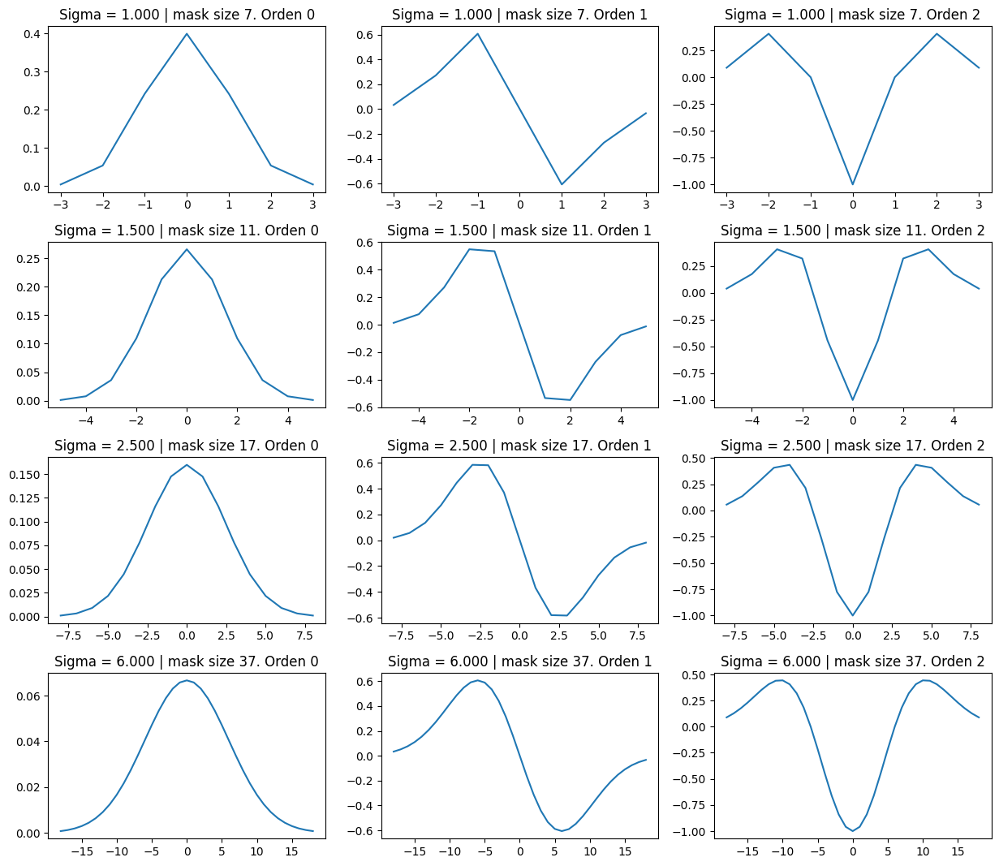

In [13]:
sigma_values = [1,1.5,2.5,6]
size_masks = [7,11,15]

#plt.rcParams["figure.figsize"] = (15,3) # para ajustar tamaño del ancho y alto (ejes)
print('FIJAMOS PRIMERO EL TAMAÑO DE LA MÁSCARA')

# Tantas filas como tamaños, y 3 columnas (orden 0, 1 y 2)
figs, axs = plt.subplots(len(size_masks),3, figsize=(15, 10))
figs.subplots_adjust(hspace=0.3) # Añadimos espacio entre las gráficas

for ind_fila, sizeMask in enumerate(size_masks):
  for i in range(0,3):
    values, sigma_result, size_result  = gaussianMask1D(sizeMask = sizeMask, order = i)
    axs[ind_fila,i].plot(values[:,0], values[:,1])
    axs[ind_fila,i].set_title(f'Mask size {size_result} | sigma = {sigma_result:.3f}. Orden {i}')

plt.show()

print('FIJAMOS AHORA EL SIGMA')

# Tantas filas como tamaños, y 3 columnas (orden 0, 1 y 2)
figs, axs = plt.subplots(len(sigma_values),3, figsize=(15, 13))
figs.subplots_adjust(hspace=0.3) # Añadimos espacio entre las gráficas

for ind_fila, sigma in enumerate(sigma_values):
  for i in range(0,3):
    values, sigma_result, size_result  = gaussianMask1D(sigma = sigma, order = i)
    axs[ind_fila,i].plot(values[:,0], values[:,1])
    axs[ind_fila,i].set_title(f'Sigma = {sigma_result:.3f} | mask size {size_result}. Orden {i}')

plt.show()

Los resultados obtenidos son razonables y parecen correctos.

A medida que aumentamos el tamaño de la máscara y el valor de sigma, la gráfica luce más redondeada, y con menos picos. Es decir, se parece cada vez más a las gráficas de las funciones obtenida en la figura anterior, ya que se muestran muchos más valores de la función.

También observamos que cuanto mayor es el orden de la derivada, mayor será el número de oscilaciones de la gráfica.

Importante observar los valores del eje Y, para comprobar que no se va perdiendo la señal al calcular las derivadas, gracias a la normalización de escala.

## B) (1.5 puntos)

<font color='blue'> En este apartado se debe leer una imagen en escala de grises (`'zebra.jpg'`) y esta debe ser filtrada mostrando el resultado de la convolución con una Gaussiana, con la primera derivada de la Gaussiana (tanto en $X$ como en $Y$), y con la segunda derivada de la Gaussiana (tanto en $X$ como en $Y$). Para ello, hay que:
1. emplear los siguientes sigmas ($\{0.75,1,2,4,8, 16\}$),
2. usar la función de OpenCV `sepFilter2D()` con las máscaras calculadas a partir de las funciones desarrolladas en el apartado anterior,
3. mostrar todas las imágenes dentro del mismo canvas, tal y como se muestra más abajo,
4. analizar los resultados obtenidos y discutir si se corresponden con lo se esperaría obtener en base a nuestro conocimiento de la teoría.




Es importante comprobar que la imagen que vamos a leer tiene formato `uint8`, es decir, es una matriz con valores de 0 a 255. En principio, trabajaremos con la imagen de esta forma (también podríamos convertirla a una imagen con valores entre 0 y 1) aunque tendremos que tener ciertas precauciones:

- La función cv2.sepFilter2D no debería usarse de la siguiente manera:
  `cv2.sepFilter2D(im,-1,maskX, maskY)`

  La opción -1 en la anterior provocará que se mantenga el formato original (uint8) de la foto, lo que provocará que los valores negativos resultantes se muestren como si fueran 0 (es decir, de color negro). Usaremos por tanto:
  `cv2.CV_64F`
  que preservará los valores negativos.
  
  Al usar `cv2.CV_64F`, obtendremos una imagen con valores reales, que pueden ser negativos. Posteriormente, la función `rangeDisplay01` reescalará los valores entre 0 y 1 para que `openCV` pueda mostrar la imagen. Por tanto, los valores más negativos serán tonos más negros, mientras que los valores más positivos serán tonos más blancos; teniendo así una representación más fidedigna. La mayoría de valores, ni muy negativos ni muy positivos, pasarán a ser tonos grisáceos al reescalar.


In [14]:
im=cv2.imread(get_image('zebra.jpg'),0)
print(im.dtype)

sigmas = [0.75,1,2,4,8,16]

uint8


In [15]:
def my2DConv(im, sigma, orders):

  if orders==[0,0]: # Suavizado Gaussiano
    maskX = gaussianMask1D(sigma=sigma, order=0)[0][:,1]
    maskY = maskX.copy()
  elif all(order >= 0 and order <= 2 for order in orders) :
    maskX = gaussianMask1D(sigma=sigma, order=orders[0])[0][:,1]
    maskY = gaussianMask1D(sigma=sigma, order=orders[1])[0][:,1]
  else:
    print('error in order of derivative')

  # Importante utilizar cv2.CV_64F ya que im.dtype puede ser 'uint8'
  return cv2.sepFilter2D(im,cv2.CV_64F,maskX, maskY)

Procedemos a aplicar el filtro gaussiano (sin derivar) a la imagen:

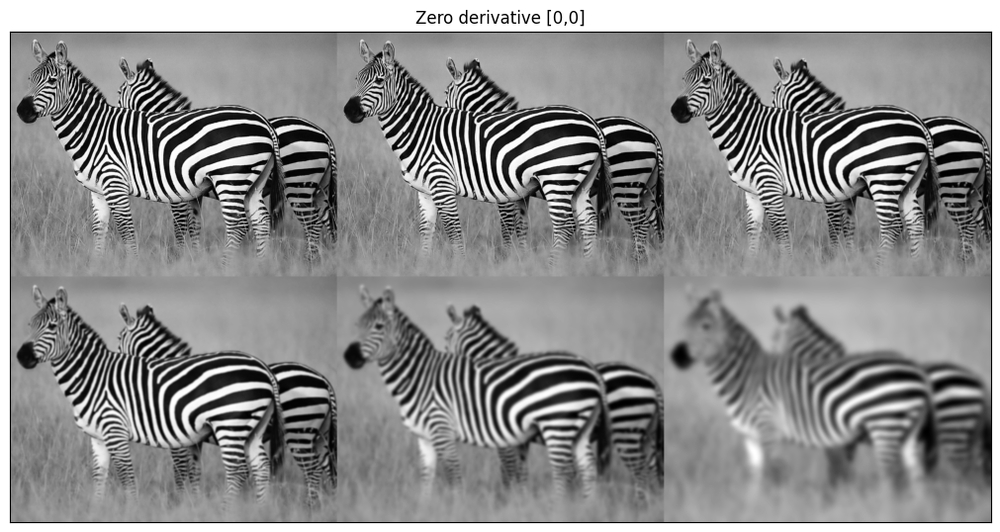

In [16]:
vim0=[]
orders=[0,0]
for sigma in sigmas:
  vim0.append(rangeDisplay01(my2DConv(im,sigma,orders),True))

#A CUBRIR POR EL ALUMNADO
displayMI_ES(vim0,'Zero derivative [0,0]',2)

El resultado es, tal y como esperábamos, un suavizado de la imagen, eliminando las altas frecuencias de la imagen, y por tanto dejando únicamente las bajas frecuencias de la imagen.

Como podemos observar, a medida que aumenta el valor de sigma, aumenta el suavizado, ya que dicho parámetro aumenta la escala a la que se realiza el suavizado. A valores pequeños, se observa únicamente un pequeño suavizado en el centro de la imagen, y a medida que va aumentando sigma, se va expandiendo hacia el resto de la imagen.

Nótese que en este caso, no se observan diferencias si se hubiera usado anteriormente:
`cv2.sepFilter2D(im,-1,maskX, maskY)`
, ya que no se obtiene ningún valor negativo al realizar la convolución.

Procedemos ahora a realizar el mismo proceso con las derivadas de orden 1 respecto de X y de Y, respectivamente. Sabemos que se verifica que:
*   $\frac{\partial G(x,y)}{\partial x} = G_h'(x) \cdot G_v(y)$
*   $\frac{\partial G(x,y)}{\partial y} = G_v'(y) \cdot G_h(x)$

, donde $G$ es una gaussiana de dos variable, $G_h$ es la gaussiana univariable en X (filas) y $G_v$ es la gaussiana univariable en Y (columnas).

Por tanto, ambas derivadas constarán de un suavizado en una dirección y una derivada en la otra dirección.

La derivada, como sabemos, está destinada a conocer la variación de los valores de los píxeles cercanos, por lo que eliminará las bajas frecuencias, para quedarse con las altas frecuencias, destacando especialmente los bordes de los elementos de la imagen.

Mostramos los resultados al realizar ambas derivadas:


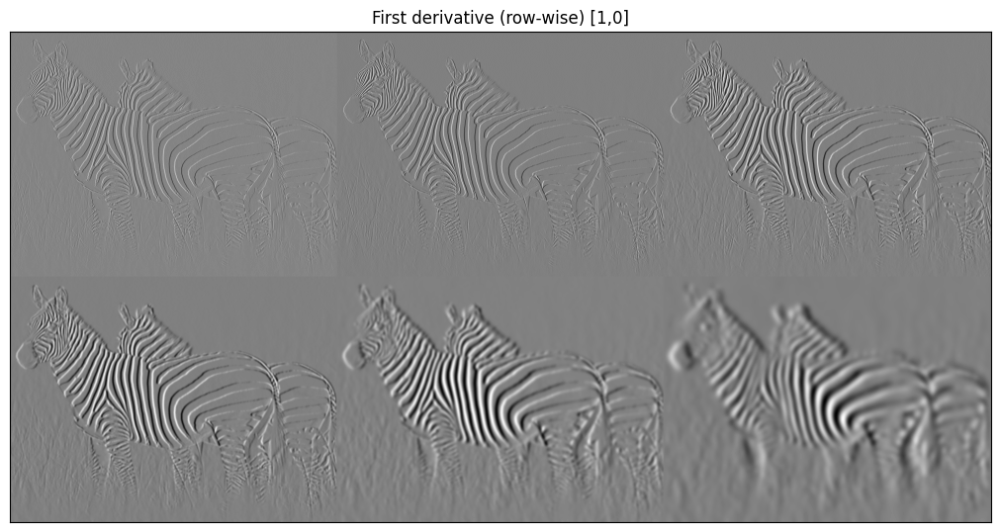

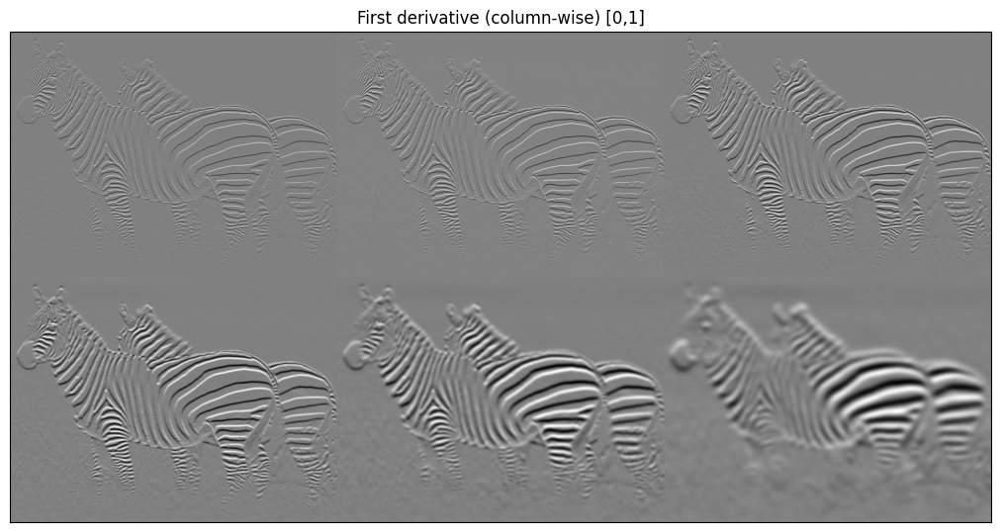

In [17]:
vim10=[]
orders=[1,0]
for sigma in sigmas:
  vim10.append(rangeDisplay01(my2DConv(im,sigma,orders),True))

#A CUBRIR POR EL ALUMNADO
displayMI_ES(vim10,'First derivative (row-wise) [1,0]',2)

vim01=[]
orders=[0,1]
for sigma in sigmas:
  vim01.append(rangeDisplay01(my2DConv(im,sigma,orders),True))

displayMI_ES(vim01,'First derivative (column-wise) [0,1]',2)

Como pensábamos, en ambos casos, los filtros han destacado especialmente los bordes de la imagen, en este caso, las rayas de ambas cebras.

La principal diferencia entre la derivada respecto a X o respecto a Y, es que la primera destaca en gran medida las rayas verticales de la cebra (obstáculo vertical), mientras que la segunda destaca mucho más las rayas horizontales (obstáculo horizontal).

Esto se corresponde con nuestra intuición, ya que como habíamos comentado la derivada respecto a X mide la variación que existe en las filas, mientras que la derivada respecto a Y medirá la variación entre las columnas.

En cuanto al valor de sigma, cuando el valor es menor, se detectan detalles más finos, como las rayas de las patas. A medida que aumenta dicho valor, se detectan los border a mayor escala, como el cuerpo de la cebra.

En este caso, sí se observaría una gran diferencia si hubiéramos utilizado:
`cv2.sepFilter2D(im,-1,maskX, maskY)`
,ya que todos los valores negativos hubieran pasado a ser negros, por lo que gran parte de la imagen sería completamente negra, y no se verían claramente los bordes delimitados.

Procedemos ahora a realizar el mismo proceso con las derivadas de orden 2 respecto de X y de Y, respectivamente. Sabemos que se verifica que:
*   $\frac{\partial^2 G(x,y)}{\partial x^2} = G_h''(x) \cdot G_v(y)$
*   $\frac{\partial^2 G(x,y)}{\partial y^2} = G_v''(y) \cdot G_h(x)$

, donde $G$ es una gaussiana de dos variable, $G_h$ es la gaussiana univariable en X (filas) y $G_v$ es la gaussiana univariable en Y (columnas).

De nuevo, ambas derivadas constan de un suavizado en una dirección y de una derivada en la otra dirección. Tanto en la primera como en la segunda derivada esto es bastante ventajoso, ya que aunque la derivada introduce ruido, el suavizado en la otra dirección lo compensa en gran medida.

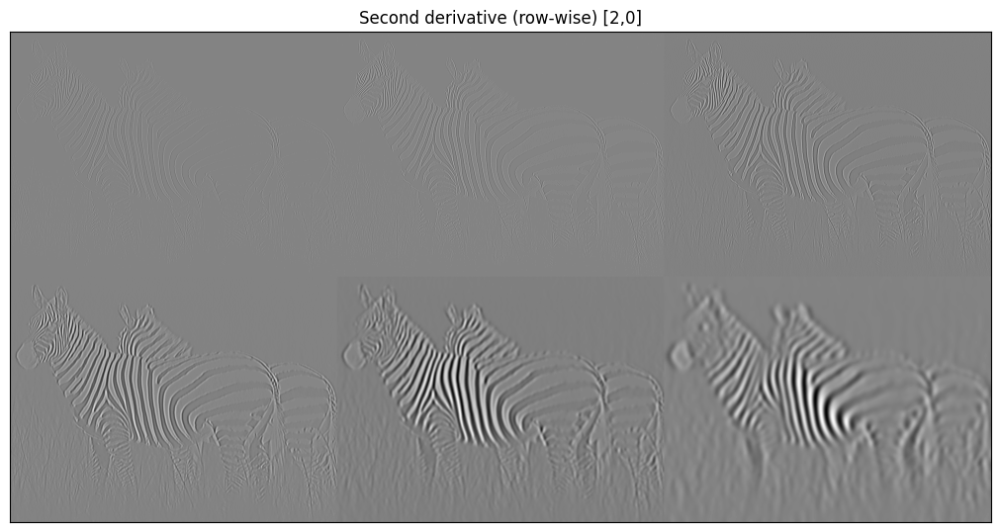

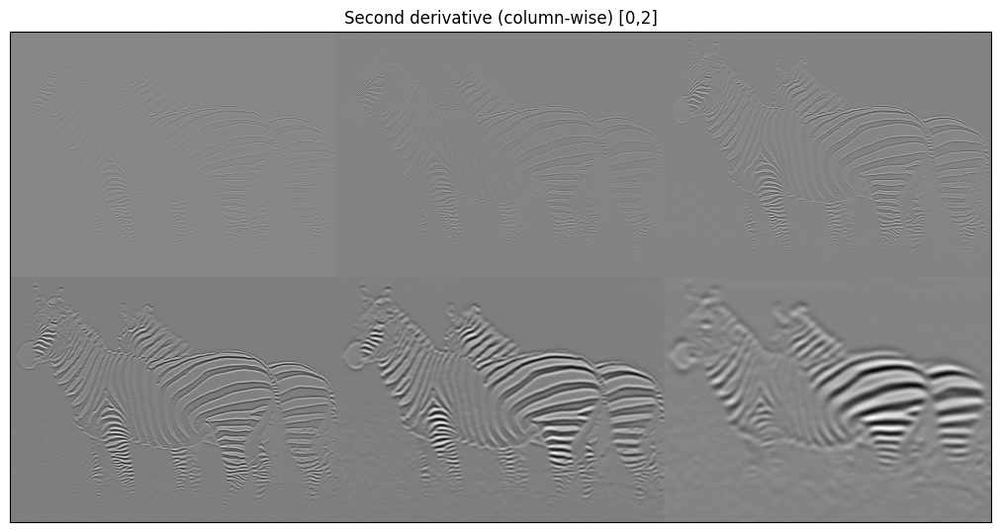

In [18]:
vim20=[]
orders=[2,0]
for sigma in sigmas:
  vim20.append(rangeDisplay01(my2DConv(im,sigma,orders),True))

displayMI_ES(vim20,'Second derivative (row-wise) [2,0]',2)

vim02=[]
orders=[0,2]
for sigma in sigmas:
  vim02.append(rangeDisplay01(my2DConv(im,sigma,orders),True))

displayMI_ES(vim02,'Second derivative (column-wise) [0,2]',2)

La segunda derivada también está destinada a la detección de bordes, y los resultados, son como esperábamos, similares a los obtenidos al realizar la primera derivada.

Teóricamente, la segunda derivada detecta más fácilmente los bordes, ya que los bordes serán simplemente los ceros de la función obtenida (zero-crossings). Sin embargo, en este caso, a simple vista, no se observan grandes diferencias respecto a la primera derivada.

## C) (1 punto)

<font color='blue'> En este apartado hay que emplear la función de OpenCV `sepFilter2D()` con $\sigma=2.0$ para calcular y mostrar el gradiente (4 imágenes: derivada en $X$, derivada en $Y$, magnitud y orientación) y la Laplaciana de la Gaussiana. Se debe explicar el trabajo realizado, incluyendo las expresiones matemáticas subyacentes y el análisis, al igual que en todos los ejercicios, relativo a si los resultados obtenidos se corresponden con lo esperado.

Como ya se ha comentado anteriormente, las expresiones de las dos **derivadas de la imagen** son el producto de la derivada gaussiana univariable por filas, en el caso de la derivada en X (por columnas en el caso de la derivada en Y) y la gaussiana sin derivar en la otra dirección.

En cuanto a la **derivada segunda**, las expresiones serán el producto de la derivada segunda de la gaussiana univariable por filas, en el caso de la derivada en X (por columnas en el caso de la derivada en Y) y la gaussiana sin derivar en la otra dirección.

A partir de esas derivadas, podemos calcular fácilmente la **magnitud del gradiente** de la imagen:
$$
|\nabla I| = \sqrt{\left(\frac{\partial I}{\partial x}\right)^2 + \left(\frac{\partial I}{\partial y}\right)^2 }
$$

, por lo que simplemente calculamos las primeras derivadas de la imagen, y sustituimos en la anterior expresión.

La **orientación del gradiente**, por su parte, se calcula con la siguiente expresión:
$$
\theta(\nabla I) = atan2\left(\frac{\partial I}{\partial x},\frac{\partial I}{\partial y}\right)
$$

, por lo que de nuevo simplemente necesitamos las primeras derivadas de la imagen y sustituir en la expresión. Nótese que se ha utilizado la función $atan2$, que es la función arcotangente del cociente de los argumentos, pero teniendo en cuenta el signo.

Finalmente, calculamos el laplaciano de la imagen:
$$
\nabla^2 I = \frac{\partial^2 I}{\partial x^2} + \frac{\partial^2 I}{\partial y^2}
$$

, por lo que sustituyendo las derivadas segundas en la anterior expresión obtenemos el resultado.



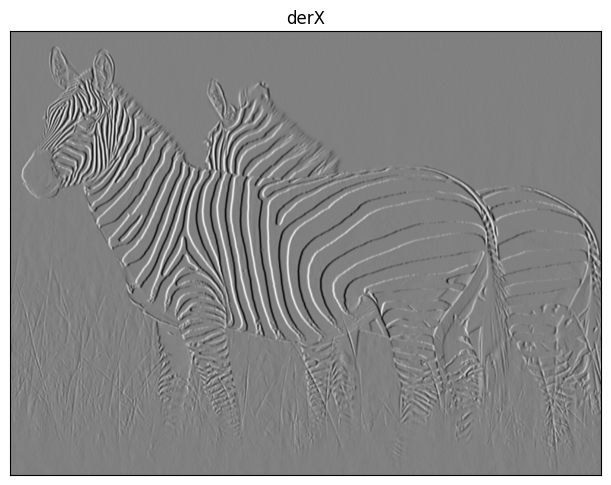

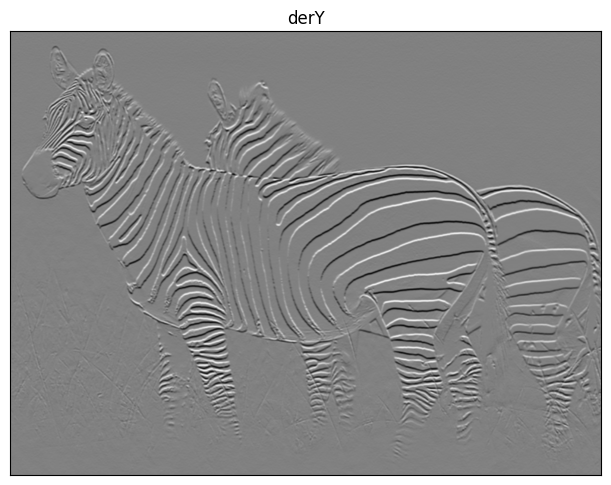

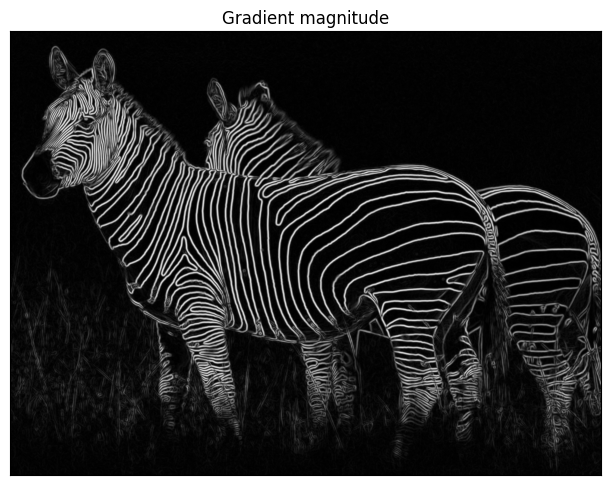

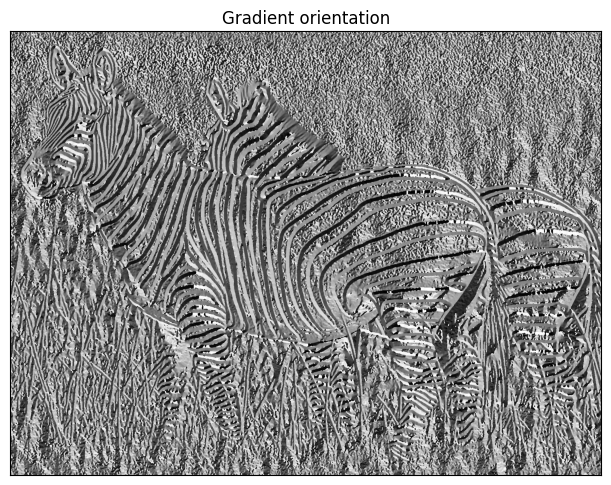

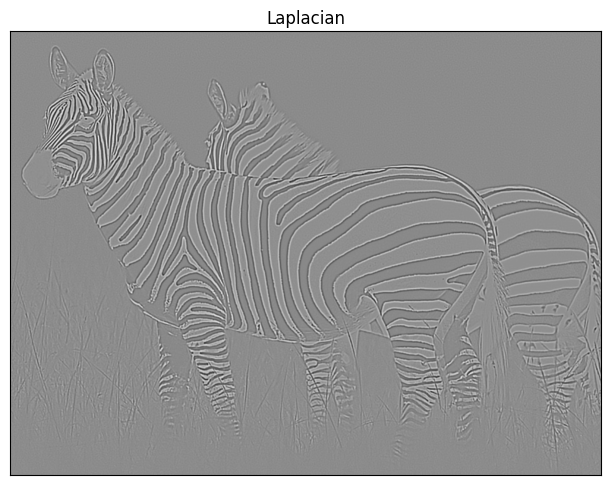

In [19]:
sigma_value = 2.0
factor_escala = 1.2

def gradientIM(im,sigma):
  dx = my2DConv(im,sigma,[1,0])
  dy = my2DConv(im,sigma,[0,1])
  return dx,dy

def laplacianG(im,sigma):
  dx2 = my2DConv(im,sigma,[2,0])
  dy2 = my2DConv(im,sigma,[0,2])
  return dx2 + dy2

# Calculamos la derivada en X y en Y de la imagen
dx,dy = gradientIM(im,sigma_value)

# Mostramos las imágenes
derX = [dx]
displayMI_ES(derX,'derX',factor_escala)

derY = [dy]
displayMI_ES(derY,'derY',factor_escala)

gradient_magnitude = np.sqrt(dx**2+dy**2)
gradient_magnitude_image = [rangeDisplay01(gradient_magnitude,True)]
displayMI_ES(gradient_magnitude_image,'Gradient magnitude',factor_escala)

gradient_orientation = np.arctan2(dx,dy)
gradient_orientation_image = [rangeDisplay01(gradient_orientation,True)]
displayMI_ES(gradient_orientation_image,'Gradient orientation',factor_escala)

laplacian_image = [rangeDisplay01(laplacianG(im,sigma_value),True)]
displayMI_ES(laplacian_image,'Laplacian',factor_escala)


Tanto la derivada en X como la derivada en Y ya se han comentado, por lo que pasamos a comentar el resto.

La magnitud del gradiente indica la magnitud de los cambios de intensidad en la imagen. Como es de esperar, en los bordes se observan los mayores cambios de intensidad, y por ello, todos los bordes se colorean de blanco. Por otra parte, las zonas de la imagen donde el color es prácticamente uniforme se colorean de negro. Obsérvese que en este caso, todos los valores obtenidos en la imagen eran positivos, y por tanto, no se observan los tonos grisáceos de las otras imágenes.

La orientación indica, para cada píxel, la dirección en la que se producen los mayores cambios de intensidad. Visualmente, es complicado identificar estas direcciones. Aun así, se puede observar de cierta forma la cebra, ya que aquellos píxeles que comparten la misma orientación (aunque estén distantes, la orientación es independiente de la cercanía de los píxeles) comparten la misma tonalidad de gris.

En cuanto al laplaciano, podemos observar que identifica bastante bien los bordes. Además, realiza un suavizado de la imagen, tanto en la dirección X, como en la Y, por lo que se obtiene una imagen con muy poco ruido, en la que los bordes están bastante bien identificados.

## D) (1.5 puntos)

<font color='blue'> Implemente una función para realizar "a mano" la convolución separable (es decir, empleando kernels 1D). Dicha función debe recibir como entrada una imagen (con el _padding_ adecuado, en caso de que lo necesite, ya incorporado) y un kernel 1D, y debe proporcionar como salida la imagen convolucionada con el kernel en ambas direcciones.

<font color='blue'> Una vez haya implementado la función, realice el suavizado de la imagen `motorcycle.bmp` (usando un _Gaussian kernel size_ de 7, y dejando que sea la propia función de creación del kernel la que determine el $\sigma$ adecuado), y compare el resultado con el de `cv2.GaussianBlur` (en donde se debe optar por la misma estrategia: fijando $ksize=7$ y dejando que sea la propia función de OpenCV la que escoja el sigma). ¿Hay diferencias (sea a nivel de resultado final o de tiempo de ejecución)? En caso afirmativo, ¿a qué se pueden deber?

In [20]:
def convolve1D(image,kernel):

  # Colocamos el kernel como un vector columna
  kernel_local = np.reshape(kernel, (-1,1))

  # Damos la vuelta al kernel (convolución! no cross-correlation)
  kernel_local = np.flip(kernel_local)

  # Primera convolución: repetimos el kernel, tantas veces como columnas tenga la imagen
  kernel_local = np.repeat(kernel_local, image.shape[1], axis=1)

  # Almacenará el resultado de la convolución
  output = np.zeros_like(image)

  # Posición central del kernel
  current_row = int(np.ceil(kernel_local.shape[0] / 2))-1

  # Se recorrerán las filas hasta que el kernel se "salga" de la imagen
  for i in range(image.shape[0]-(kernel_local.shape[0]-1)):
    # Producto escalar de las columnas del kernel por las columnas actuales de la imagen
    output[current_row] = np.sum(kernel_local * image[i:kernel_local.shape[0]+i,:],axis=0)
    current_row += 1

  return output

def convolve2D(image, kx, ky):
  # Imagen resultado de la primera convolución traspuesta
  output = convolve1D(image, kx).transpose()

  # Realizamos la segunda convolución y trasponemos de nuevo
  return convolve1D(output,ky).transpose()

Implementamos la convolución utilizando un único bucle for en cada una de las dos convoluciones. Este bucle recorrerá únicamente las filas de la imagen (en la segunda convolución, las columnas).

Conseguimos ahorrarnos el bucle al recorrer las columnas de la imagen (las filas en la segunda convolución) utilizando la función `np.repeat` que repite el kernel varias veces. Nos ahorramos también un bucle for para recorrer las columnas al utilizar las funciones de numpy `np.sum`.

También conseguimos ahorrarnos una implementación diferente para la segunda convolución utilizando únicamente la trasposición.

Podemos ya pasar a realizar una convolución de ejemplo con la fotografía de la motocicleta:

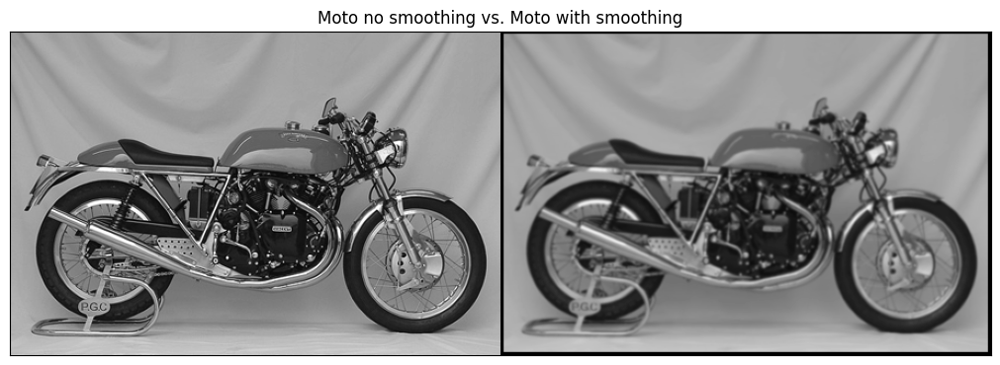

In [21]:
filename = 'motorcycle.bmp'
image_moto=cv2.imread(get_image(filename),0)

#A CUBRIR POR EL ALUMNADO
size = 7
kernel_gauss = gaussianMask1D(sizeMask = 7, order=0)[0][:,1]
smooth_image_moto = convolve2D(image_moto,kernel_gauss, kernel_gauss)

displayMI_ES([image_moto, smooth_image_moto],'Moto no smoothing vs. Moto with smoothing',2)

Si no queremos perder parte de la imagen original, podríamos añadir un padding previamente a la imagen original.

Para que el primer píxel de la imagen se corresponda con el centro del kernel, que tiene tamaño 7, tendremos que añadir 3 filas para la primera convolución y 3 columnas para la segunda convolución. Usamos para ello la función `np.pad` de numpy:

In [22]:
image_moto_padding = np.pad(image_moto, 3, 'constant', constant_values=0)

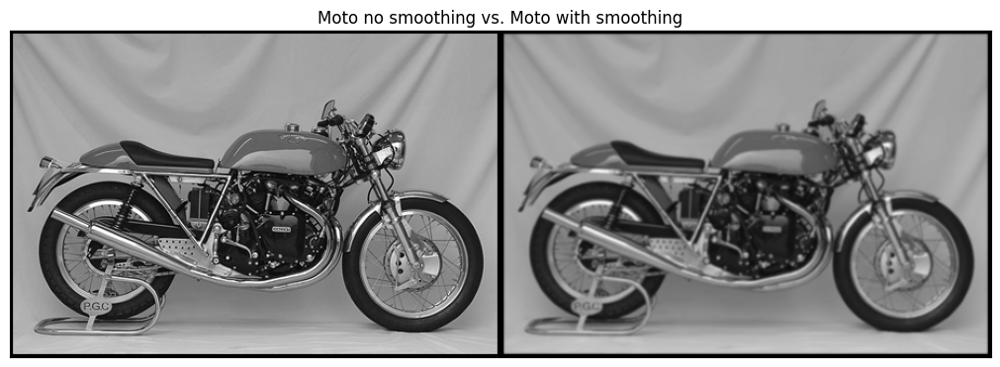

In [23]:
kernel_gauss = gaussianMask1D(sizeMask = 7, order=0)[0][:,1]
smooth_image_moto = convolve2D(image_moto_padding,kernel_gauss, kernel_gauss)

displayMI_ES([image_moto_padding, smooth_image_moto],'Moto no smoothing vs. Moto with smoothing',2)

Conseguimos así no perder ninguna parte de la imagen original. También comprobamos que, a simple vista, la convolución está funcionando correctamente, eliminando las altas frecuencias de la imagen, y dejando una imagen suavizada.

Comparemos ahora la convolución implementada a mano con la función de OpenCV llamada `cv2.GaussianBlur`. Dicha función nos pide el tamaño del kernel, que será 7x7 y la desviación estándar en X (si se elige como 0, se calculará a partir del tamaño del kernel).
Observemos las diferencias:

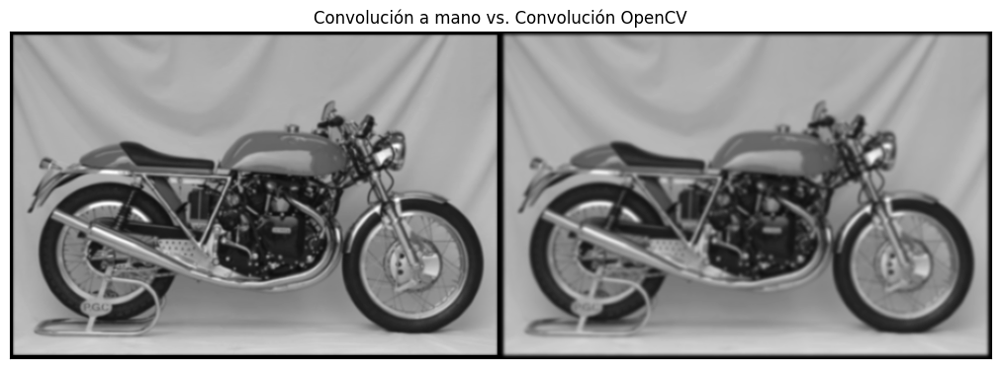

In [24]:
smooth_image_moto_cv = cv2.GaussianBlur(image_moto_padding, ksize= (7,7) , sigmaX = 0)

displayMI_ES([smooth_image_moto, smooth_image_moto_cv],'Convolución a mano vs. Convolución OpenCV',2)

Podemos observar que los resultados obtenidos son algo distintos. En un principio, parece que el suavizado que realiza OpenCV es algo mayor. La primera diferencia que podemos pensar es que, el kernel y el sigma que está usando OpenCV es diferente del que estamos usando nosotros.

Según la documentación de OpenCV [[1]](https://docs.opencv.org/2.4/modules/imgproc/doc/filtering.html?highlight=gaussianblur#gaussianblur), el sigma y el kernel que usa OpenCV será el usado por la función `getGaussianKernel`, es decir:

- $\sigma = 0.3 \cdot ((ksize-1)\cdot 0.5 - 1) + 0.8 = 1.4 $, si $ksize=7$.

Nosotros, por otra parte, estábamos considerando un valor de sigma:

- $\sigma = ((ksize-1) / 2) / 3 = 1$, si $ksize = 7$.

, por lo que observamos ya una diferencia importante.


Podemos comprobar que si usamos un $\sigma = 1.4$ los resultados serán mucho más similares:

In [25]:
cv2.getGaussianKernel(ksize=7, sigma = 0)

array([[0.03125 ],
       [0.109375],
       [0.21875 ],
       [0.28125 ],
       [0.21875 ],
       [0.109375],
       [0.03125 ]])

In [26]:
kernel_test = []

for i in range(-3,3+1) :
  kernel_test.append([i,GaussFunc(i,1.4)])

kernel_test = np.array(kernel_test)
kernel_test = kernel_test[:,1] / np.sum(kernel_test[:,1])
kernel_test

array([0.02899527, 0.10381835, 0.22317336, 0.28802605, 0.22317336,
       0.10381835, 0.02899527])

y salvo por ligeras variaciones de redondeo, los kernel ahora son muy similares.
Veamos el resultado:

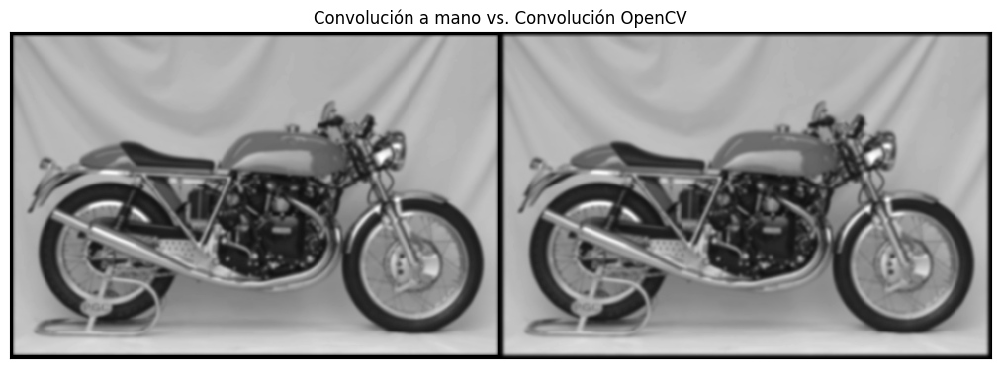

In [27]:
smooth_image_moto = convolve2D(image_moto_padding,kernel_test, kernel_test)

displayMI_ES([smooth_image_moto, smooth_image_moto_cv],'Convolución a mano vs. Convolución OpenCV',2)

Comprobamos visualmente que los resultados son muy similares ahora.

En cuanto a velocidad de ejecución, lo esperable es que OpenCV tenga una mayor velocidad que nuestro algoritmo implementado:

In [28]:
import time

start = time.time()
convolve2D(image_moto_padding, kernel_test, kernel_test)
end = time.time()
print(f'{end - start} segundos en el algoritmo implementado a mano.')

start = time.time()
cv2.GaussianBlur(image_moto_padding, ksize= (7,7) , sigmaX = 0)
end = time.time()
print(f'{end - start} segundos en el algoritmo de OpenCV.')

0.014255046844482422 segundos en el algoritmo implementado a mano.
0.001135110855102539 segundos en el algoritmo de OpenCV.


Como se puede comprobar, la eficiencia de OpenCV es bastante mayor que la del algoritmo que nosotros hemos implementado.

## E) (0.5 puntos)

<font color='blue'> Las herramientas de IA generativa son de gran utilidad tanto para estudiantes como para docentes. No obstante, resulta fundamental tener una actitud crítica y asumir desde el principio que las respuestas proporcionadas por estas herramientas pueden ser factualmente incorrectas (véase,  por ejemplo, https://elpais.com/tecnologia/2024-09-25/los-nuevos-modelos-de-ia-como-chatgpt-persiguen-la-superinteligencia-pero-no-logran-ser-fiables-ni-en-preguntas-bobas.html). En este sentido, vale la pena recordar lo que indica la guía de la UGR (https://ceprud.ugr.es/formacion-tic/inteligencia-artificial): _"Debes revisar siempre la salida que genera y las posibles referencias que utilice. [...] Mejora tus resultados con la IAGen aprendiendo a usarla y a comunicarte con ella de manera adecuada. Pero no dejes que piense por ti."_

<font color='blue'> En este apartado trabajaremos de forma crítica la utilidad de estas herramientas. Para ello, el alumnado debe emplear ChatGPT (https://chatgpt.com/) para consultar _"en qué consiste y para qué sirve la normalización de escala, así como por qué, en dicha normalización de escala, se multiplica por $\sigma^n$, siendo $n$ el orden de derivada"_. No se trata meramente de copiar lo que indique ChatGPT como salida, sino de analizar y matizar su respuesta, confrontándola con otras lecturas y lo que el estudiante sabe de la teoría, indicando en qué aspectos dicha respuesta puede considerarse correcta y en qué aspectos quizás no lo es.

Se ha explicado a ChatGPT cómo hemos calculado los kernels gaussianos así como sus derivadas. Posteriormente, se ha realizado la pregunta en cuestión:

*En el caso de las derivadas, sin embargo, es necesario realizar lo que se llama normalización de escala. En qué consiste y para qué sirve la normalización de escala, así como por qué, en dicha normalización de escala, se multiplica por sigma^n, siendo n el orden de derivada*

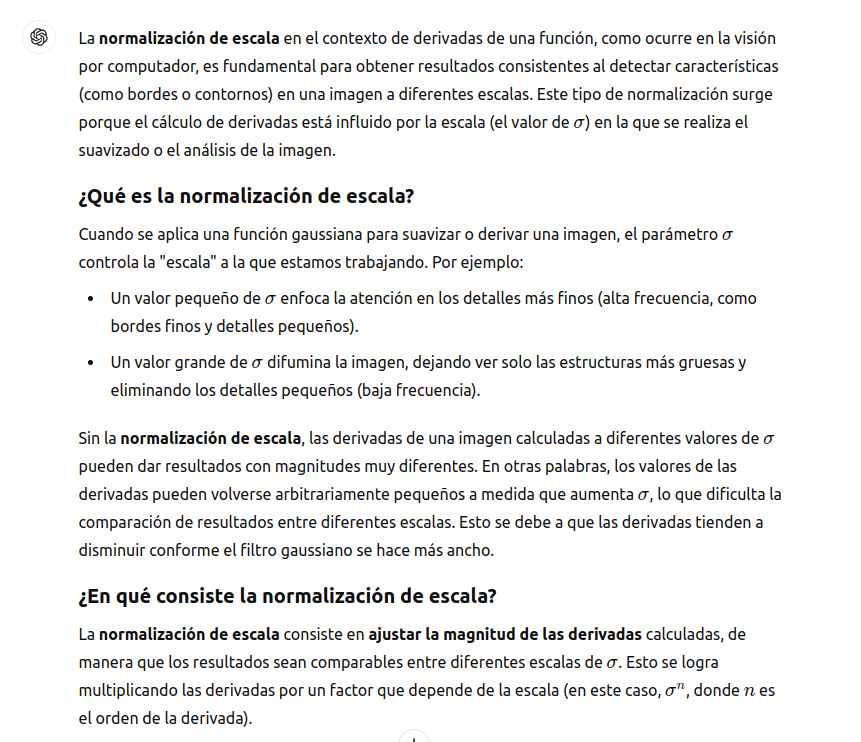

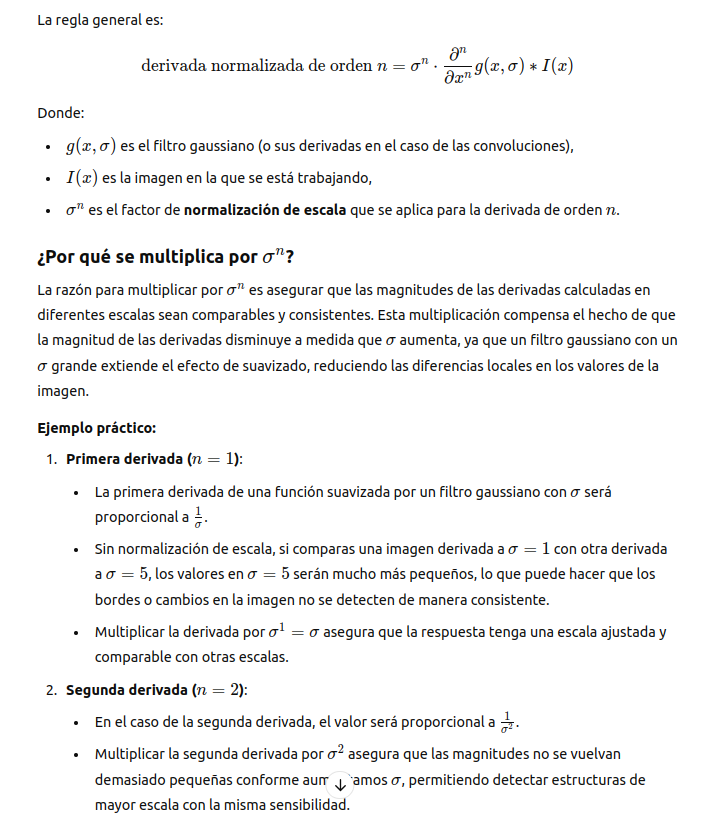

La verdad que la respuesta es bastante acertada, y todo lo que comenta es correcto.

Acierta en la función que tiene el sigma en el suavizado, y el motivo principal de la normalización en escala, que es que los valores que se obtienen en las sucesivas derivadas no vayan disminuyendo a medida que aumenta el sigma.

Algo que sería recomendable añadir es que, el motivo por el que las derivadas van disminuyendo cuando aumenta $\sigma$ y el motivo por el que el factor de escala es precisamente $\sigma^n$ se debe a la expresión matemática de las derivadas de la gaussiana.

Por ejemplo, en el caso $n=1$:
$$
G'(x) = \frac{-x}{\sigma^2} \text{exp}\left( \frac{-x^2}{2\sigma^2} \right)
$$

Si queremos que, lo anterior sea adimensional simplemente el factor que multiplica a la exponencial debería ser $\frac{-x}{\sigma}$, que es lo que conseguimos al multiplicar por $\sigma$.

De hecho, utilizando la segunda derivada, sabemos que $G'(x)$ alcanza su máximo y su mínimo en $x = -\sigma$ y $x = \sigma$. Si no multiplicamos por $\sigma$, tendríamos que los valores máximo y mínimo de $G'(x)$ serían:

$$
\frac{-1}{\sigma} \text{exp}\left( \frac{-1}{2}\right), \frac{1}{\sigma} \text{exp}\left( \frac{-1}{2}\right)
$$

y a medida que aumentáramos el $\sigma$ dichos valores disminuirían rápidamente (en valor absoluto). Esto sería bastante más grave en el caso de la segunda derivada, donde dividiríamos por $\sigma^2$.

# **Ejercicio 2**:  Pirámides Gaussianas y Laplacianas (3.5 puntos)







## A) (1.5 puntos)

<font color='blue'> Construya una pirámide Gaussiana de 4 niveles empleando máscaras Gaussianas de tamaño $7\times7$. No se permite emplear las funciones `pyrUp()` y `pyrDown()` de OpenCV, ni tampoco `cv2.resize()`.

In [29]:
'''
This function displays a pyramid of images, providing as input the list of images to display.

Example of use:
im1=readIm(get_image('apple.jpg'),1)
images = [im1, cv2.resize(im1,(im1.shape[0]//2,im1.shape[1]//2),cv2.INTER_LINEAR), cv2.resize(im1,(im1.shape[0]//4,im1.shape[1]//4),cv2.INTER_LINEAR), cv2.resize(im1,(im1.shape[0]//8,im1.shape[1]//8),cv2.INTER_LINEAR), cv2.resize(im1,(im1.shape[0]//16,im1.shape[1]//16),cv2.INTER_LINEAR)]

displayPyramid(images, title='Piramide de Manzanas')

'''
def displayPyramid(vim, title='result'):
  temp = np.zeros_like(vim[0])
  if np.mod(temp.shape[1],2)==0:
    h = temp[:, :temp.shape[1]//2]
  else:
    h = temp[:, :(temp.shape[1]//2)+1]
  out = np.hstack((temp, h))
  top = 0
  out[0:vim[0].shape[0], 0:vim[0].shape[1]] = vim[0]
  left = vim[0].shape[1]
  for i in range(1, len(vim)):
    out[top:top+vim[i].shape[0], left:left + vim[i].shape[1]] = vim[i]
    top += vim[i].shape[0]
  displayIm(out, title)

El proceso para construir la pirámide Gaussiana es el siguiente: se suaviza la imagen usando una máscara gaussiana, y se reduce su tamaño (eliminando parte de las filas y columnas de la imagen).

A partir de la imagen obtenida reducida, repetimos el proceso hasta obtener 4 imágenes de distintos tamaños (realmente 5 si contamos la imagen original).

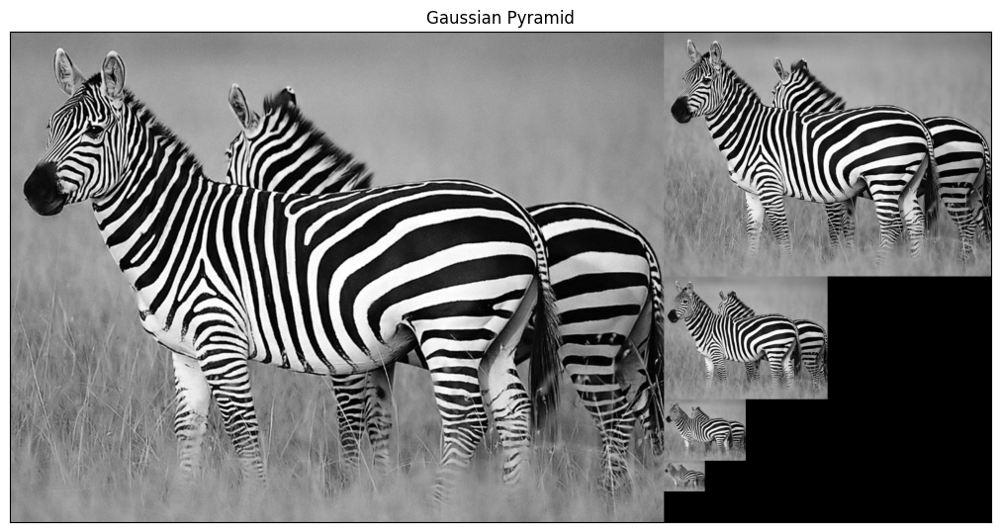

In [30]:
def pyramidGauss(im,sizeMask=7, nlevel=4, smooth=True):

  pyramid = [im]

  sigma = (sizeMask - 1) / 2 / 3

  image_aux = im.copy()

  for i in range(nlevel):
    # Filtro Gaussiano
    if smooth:
      image_aux = my2DConv(image_aux,sigma,[0,0])

    # Nos quedamos con las filas y columnas pares
    image_aux = image_aux[::2,::2]
    pyramid.append(image_aux)

  return pyramid

im=cv2.imread(get_image('zebra.jpg'),0).astype('float64')

pyrG = pyramidGauss(im,sizeMask=7, nlevel=4)
displayPyramid(pyrG,'Gaussian Pyramid')


Obtenemos 4 imágenes (además de la original), y por cada nivel que subimos en la pirámide, la imagen tendrá la mitad de filas y la mitad de columnas que la imagen del nivel inmediatamente inferior.

Al reducir las dimensiones de la imagen, introduimos ruido que, como comprobaremos en el apartado C, el suavizado corrige en gran medida.

A pesar de dicho suavizado, es importante comprobar la pérdida de resolución de las imágenes. Obviamente, una imagen tan pequeña (menos cantidad de información) como la que encontramos en el último nivel no puede tener la misma nitidez que la imagen que encontramos en el primer nivel (mucha más información). Veámoslo:


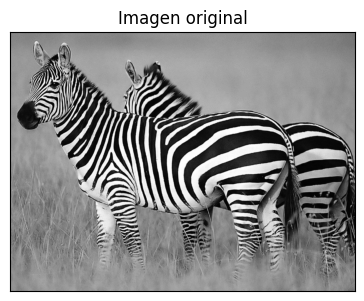

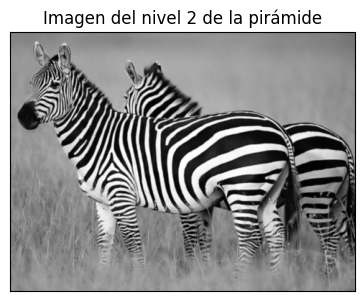

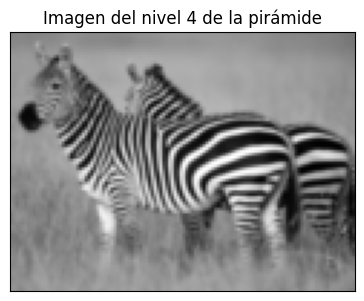

In [31]:
displayMI_ES([pyrG[0]], title='Imagen original', factor=0.7)
displayMI_ES([pyrG[2]], title='Imagen del nivel 2 de la pirámide', factor=0.7)
displayMI_ES([pyrG[4]], title='Imagen del nivel 4 de la pirámide', factor=0.7)

Los detalles más finos, como las rayas de las patas de las cebras, se van eliminando a medida que aumentamos el nivel de la pirámide. En los niveles más elevados, se preservan únicamente las regiones más grandes de la imagen, como el cuerpo de las cebras.

Se pierden tantos detalles que, de hecho es imposible reconstruir la imagen original utilizando únicamente la imagen del último nivel, ni aunque intentáramos aumentar su tamaño al de la imagen original:

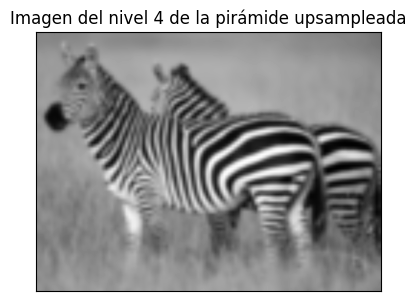

In [32]:
upsample = cv2.resize(pyrG[4], dsize=pyrG[0].shape[::-1])
displayMI_ES([upsample], title='Imagen del nivel 4 de la pirámide upsampleada', factor=0.7)

Aunque entre la imagen original y el nivel 4 de la pirámide sí se observa una gran pérdida de calidad, observamos que en el nivel 2 (imagen con el 25% de filas y el 25% de columnas de la original) se pierden muy pocos detalles, a pesar de ser una imagen bastante más pequeña.

A pesar de la inevitable pérdida de resolución, en ninguno de los casos se observan grandes dientes de sierra (*aliasing*). Esto es gracias al suavizado que hemos realizado antes de cada downsampling.

Quizás cabe destacar la cantidad de espacio que ocupa la pirámide gaussiana. Puede parecer que se está almacenando mucha más información que si solo guardamos la imagen original, pero realmente como cada imagen tiene la mitad de filas y la mitad de columnas que la imagen del nivel anterior, tendrá el 25% del área de la imagen del nivel anterior. Por tanto:

$$
1+\frac{1}{4}+\left(\frac{1}{4}\right)^2+\left(\frac{1}{4}\right)^3+\left(\frac{1}{4}\right)^4 < \sum_{n=0}^\infty \left(\frac{1}{4}\right)^n = \frac{4}{3} \approx 1.3333
$$

Es decir, solo se guarda $\frac{1}{3}$ de la imagen original de información adicional.

## B) (1 punto)

<font color='blue'> Use su código del apartado anterior para implementar una función que permita construir una pirámide Laplaciana de 4 niveles.

El proceso para construir la pirámide Laplaciana es el siguiente:
- Construimos la pirámide gaussiana, utilizando el proceso explicado en el apartado anterior.
- El último nivel de la pirámide gaussiana será el nivel 0 de la pirámide laplaciana.
- Para construir el primer nivel, aumentamos el tamaño de la imagen del primer nivel de la pirámide laplaciana (para ello, utilizaremos la función `cv2.resize`, utilizando interpolación bilineal, es decir, para calcular la intensidad de cada píxel, se realizarán dos interpolaciones lineales, una en el eje X y otra en el eje Y), obteniendo así una imagen upsampleada. Finalmente, calculamos la diferencia entre la imagen obtenida en el penúltimo nivel de la pirámide gaussiana y la imagen upsampleada anterior.
- A partir de la imagen obtenida en el segundo nivel, podemos construir el segundo nivel upsampleando la imagen, y calculando la diferencia entre la imagen del segundo nivel de la pirámide gaussiana y la imagen upsampleada.
- Continuamos con el proceso hasta obtener el nivel 4.

A pesar de no estar aplicando el operador laplaciano, la pirámide recibe este nombre ya que la laplaciana se aproxima por la diferencia de dos gaussianas, que es el proceso que estamos realizando, ya que realmente estamos calculando la diferencia entre dos niveles de la pirámide gaussiana (aunque una de ellas upsampleada).

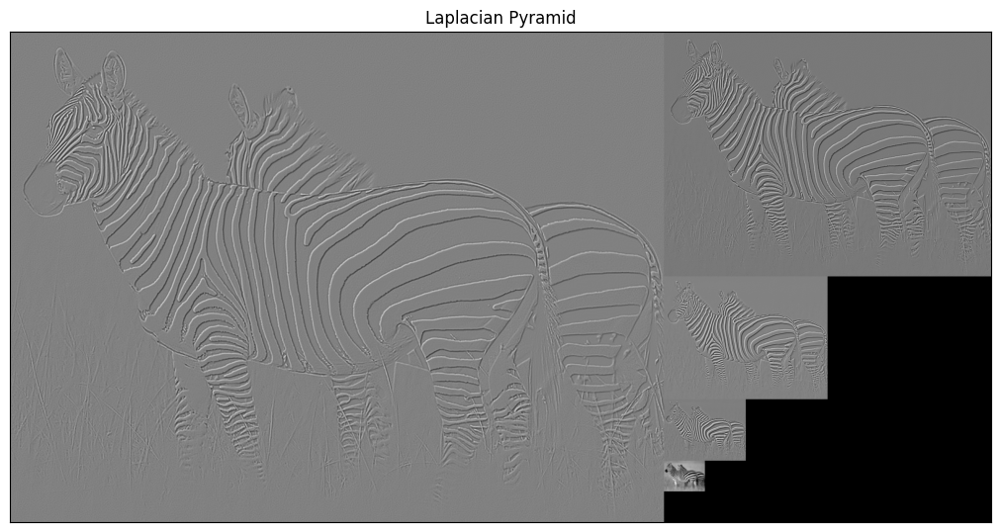

In [33]:
def pyramidLap(im, sizeMask, nlevel=4,flagInterp=cv2.INTER_LINEAR, smooth=True):

  pyrGaussian = pyramidGauss(im, sizeMask=sizeMask, nlevel=nlevel, smooth = smooth)

  # Nivel 0 = último nivel de la pirámide gaussiana
  pyrL = [pyrGaussian[-1]]

  for nivel_actual in range(nlevel-1, -1, -1):

    # Upsampling

    # Calculamos las dimensiones del siguiente nivel (columnas, filas)
    dsize = pyrGaussian[nivel_actual].shape[::-1]
    upsample = cv2.resize(pyrGaussian[nivel_actual+1], dsize=dsize, interpolation = flagInterp)

    pyrL.append(pyrGaussian[nivel_actual]- upsample)

  return pyrL

#A CUBRIR POR EL ALUMNADO

im = cv2.imread(get_image('zebra.jpg'),0).astype('float64')

pyrL = pyramidLap(im,sizeMask=7, nlevel=4)
pyrL.reverse()

pyrL01 = []

for level in pyrL:
  pyrL01.append(rangeDisplay01(level,True))

displayPyramid(pyrL01,'Laplacian Pyramid')

Comentamos algunos aspectos de la implementación anterior:
- Al calcular la diferencia, podemos obtener números negativos, que pueden provocar errores en la visualización. Por tanto, para visualizar, reescalamos entre 0 y 1 los valores. Además, para evitar problemas, trabajaremos siempre con flotantes.
- Al usar resize, es preferible utilizar la implementación anterior que utilizar:
```
cv2.resize(pyrGaussian[nivel_actual+1], dsize=(0,0), fx = 2.0, fy = 2.0, interpolation = flagInterp)
```

Es decir, upsampleamos la imagen para obtener una imagen con el doble de filas y el doble de columnas.
Obtenemos así una imagen que tendrá siempre un número de filas y columnas pares. En el caso de que el nivel `nivel_actual` de la pirámide gaussiana tenga filas o columnas impares, al calcular la diferencia entre las imágenes nos dará un error. Por ejemplo:





In [34]:
im=cv2.imread(get_image('motorcycle.bmp'),0).astype('float64')

pyrG = pyramidGauss(im,sizeMask=7,nlevel=4)

print(f'Pirámide Gaussiana nivel 3 = {pyrG[3].shape}')
upscale_image = cv2.resize(pyrG[4], dsize=(0,0), fx = 2.0, fy = 2.0)
print(f'Imagen obtenida después del upscaling = {upscale_image.shape}')

Pirámide Gaussiana nivel 3 = (38, 57)
Imagen obtenida después del upscaling = (38, 58)


Comentamos los resultados obtenidos. Obtenemos 5 imágenes, contando la imagen de la cima de la pirámide gaussiana.

Como se explicó en el punto anterior, cuanto mayor sea el nivel de la pirámide gaussiana, menor será el número de detalles que se conservan de la imagen. Al restar una imagen de un nivel menor con una de nivel mayor (upsampleada), quedarán únicamente los detalles de la imagen que ya no están presentes en el siguiente nivel.

Es por ello que obtenemos 5 imágenes con únicamente los detalles de las imágenes, es decir, las altas frecuencias de la imagen. Se observa, como es lógico, el mismo comportamiento que en la pirámide gaussiana: en las imágenes más pequeñas se observan únicamente las zonas más grandes de la imagen, mientras que en las imágenes de mayor tamaño se observan los detalles más finos.

Sorprendentemenete, utilizando estas 5 imágenes sí podemos reconstruir la imagen original, como comprobaremos en el apartado D.

## C) (0.5 puntos)

<font color='blue'> Ahora realice la misma operación que en los apartados anteriores, pero sin suavizar antes de hacer subsampling a la hora de crear la pirámide Gaussiana. ¿Hay diferencias visuales en la pirámide Laplaciana generada? ¿A qué se pueden deber estas?

Veamos si observamos alguna diferencia en la pirámide gaussiana:

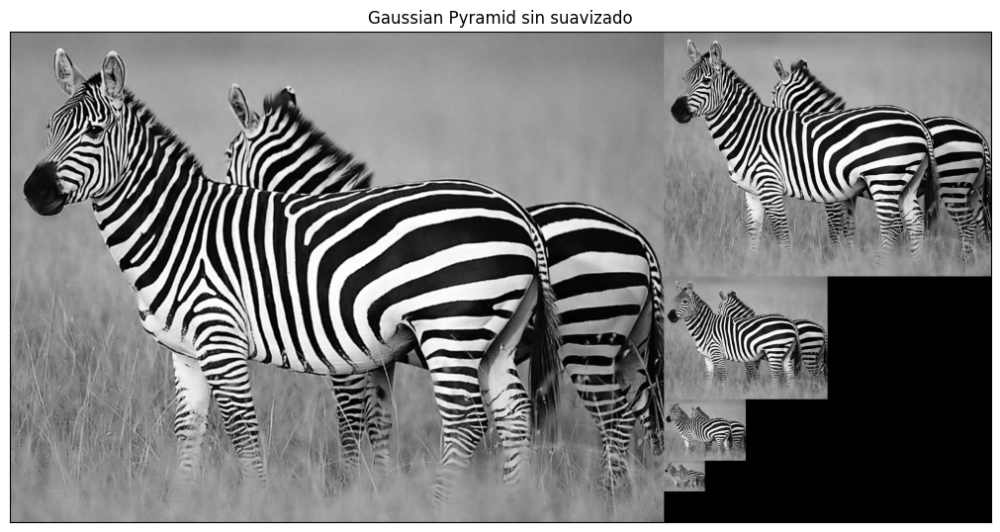

In [35]:
im=cv2.imread(get_image('zebra.jpg'),0).astype('float64')

pyrGNoSmooth = pyramidGauss(im,sizeMask=7, nlevel=4, smooth=False)
displayPyramid(pyrGNoSmooth,'Gaussian Pyramid sin suavizado')

Mostrando de esta forma las imágenes, no conseguimos visualizar ninguna diferencia. Veamos a un tamaño mayor las imágenes más pequeñas y comparémoslas con las imágenes con suavizado:

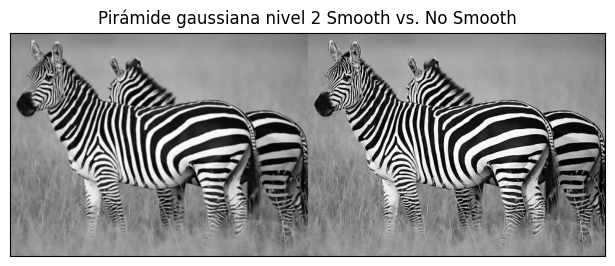

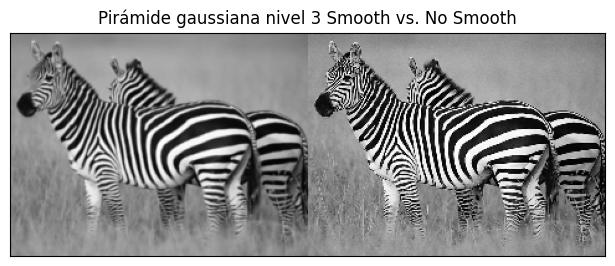

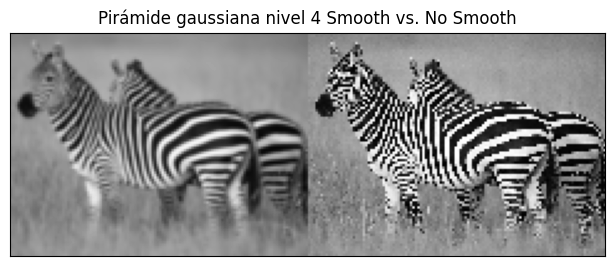

In [36]:
pyrG = pyramidGauss(im,sizeMask=7, nlevel=4)

displayMI_ES([pyrG[2], pyrGNoSmooth[2]], title='Pirámide gaussiana nivel 2 Smooth vs. No Smooth', factor=1.2)
displayMI_ES([pyrG[3], pyrGNoSmooth[3]], title='Pirámide gaussiana nivel 3 Smooth vs. No Smooth', factor=1.2)
displayMI_ES([pyrG[4], pyrGNoSmooth[4]], title='Pirámide gaussiana nivel 4 Smooth vs. No Smooth', factor=1.2)

Aunque en el nivel 2 no se aprecian apenas diferencias, tanto en el nivel 3, como especialmente en el 4, las diferencias son enormes.

Cuando no se realiza el suavizado, se observa una imagen con grandes dientes de sierra, debido a la gran cantidad de ruido que tiene. Al realizar el suavizado, la imagen se puede apreciar mucho mejor, y se elimina completamente el aliasing de la imagen sin suavizar.

Comprobamos así que la eliminación de filas y columnas de la imagen, provoca un incremento de las altas frecuencias de la imagen, lo que conlleva un gran aumento del ruido de la imagen. Este efecto es corregido en gran medida por el suavizado gaussiano, realizado antes de cada subsampling.

Veamos las diferencias en la pirámide laplaciana:

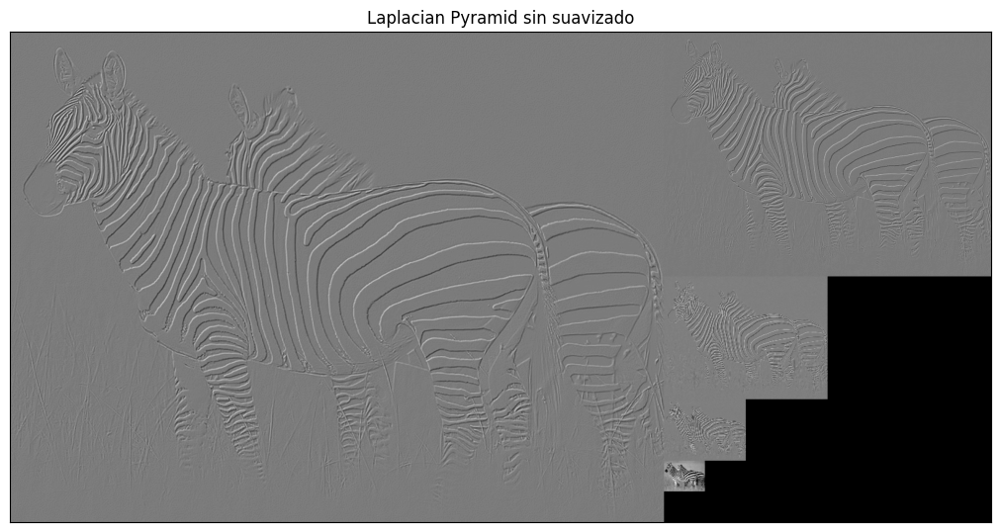

In [37]:
pyrLNoSmooth = pyramidLap(im,sizeMask=7, nlevel=4, smooth=False)
pyrLNoSmooth.reverse()

pyrLNoSmooth01 = []

for level in pyrLNoSmooth:
  pyrLNoSmooth01.append(rangeDisplay01(level,True))

displayPyramid(pyrLNoSmooth01,'Laplacian Pyramid sin suavizado')

En este caso, incluso mostrando todas las imágenes a su tamaño, se pueden observar ya ciertos cambios especialmente en las tres imágenes más pequeñas. Se puede observar que se muestran los detalles, pero con una gran cantidad de ruido.

La pirámide laplaciana se queda con las altas frecuencias de la imagen a diferentes escalas, y por tanto, si las imágenes de la pirámide gaussiana tienen más ruido (y por tanto, más altas frecuencias) la diferencia resulta visualmente más notable.

Veámoslo de forma más ampliada:

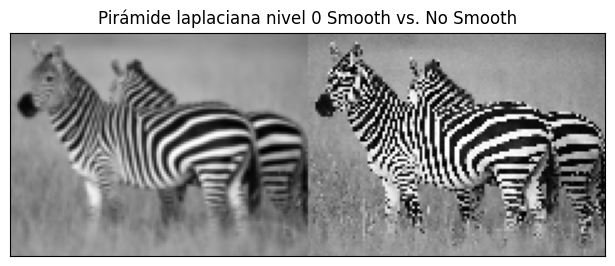

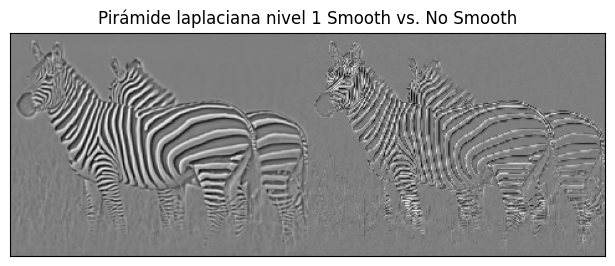

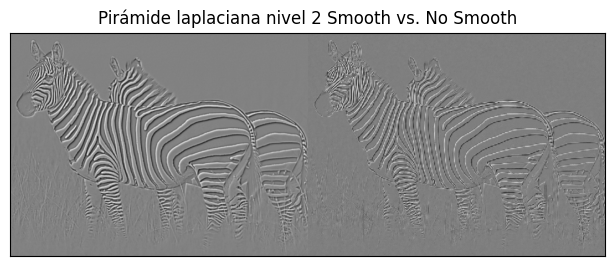

In [38]:
pyrL01.reverse()
pyrLNoSmooth01.reverse()

displayMI_ES([pyrL01[0], pyrLNoSmooth01[0]], title='Pirámide laplaciana nivel 0 Smooth vs. No Smooth', factor=1.2)
displayMI_ES([pyrL01[1], pyrLNoSmooth01[1]], title='Pirámide laplaciana nivel 1 Smooth vs. No Smooth', factor=1.2)
displayMI_ES([pyrL01[2], pyrLNoSmooth01[2]], title='Pirámide laplaciana nivel 2 Smooth vs. No Smooth', factor=1.2)

Las diferencias son enormes. En las imágenes suavizadas observamos los detalles de las imágenes perfectamente y apreciamos los bordes perfectamente delineados.

En las imágenes sin suavizar, especialmente en el nivel 1, las imágenes presentan una gran cantidad de ruido. La cabeza y las patas de la cebra, por ejemplo, son prácticamente inapreciables, tanto en el nivel 1 como en el 2.

De nuevo, las diferencias se deben a la gran cantidad de ruido que introducimos al eliminar filas y columnas de la imagen en la construcción de la pirámide gaussiana, resultando así en un pegado de zonas no contiguas, y provocando un aumento de las altas frecuencias.

## D) (0.5 puntos)

<font color='blue'> Implemente ahora una función para reconstruir la imagen codificada en la pirámide Laplaciana del apartado 2.B. Verifique que es posible obtener una copia exacta de la imagen original. Para ello, calcule el error de reconstrucción como el _Root Mean Squared Error_ (RMSE) entre los niveles de intensidad de la imagen original y la imagen reconstruida.

Para construir la imagen original a partir de la pirámide Laplaciana, el proceso que debemos seguir es ir construyendo la pirámide gaussiana hasta llegar al primer nivel (imagen original).

El último nivel de la pirámide gaussiana coincide con la imagen más pequeña de la pirámide laplaciana.

Para obtener el siguiente nivel de la gaussiana, tomamos la imagen del nivel anterior ya construido de la pirámide gaussiana, la upsampleamos al doble de filas y doble de columnas, y la sumamos al nivel 1 de la pirámide laplaciana.

Repetiremos este proceso hasta llegar a la base de la pirámide gaussiana, y con ello a la imagen orginal. Realmente, el proceso que estamos haciendo es proceso inverso a la construcción de la pirámide laplaciana, y por ello sumamos en lugar de restar.

In [79]:
def reconstructLap(pyL, flagInterp=cv2.INTER_LINEAR):

  reconstructions = [pyL[0]]

  for nivel_actual in range(1,len(pyL)):
    upsampling = cv2.resize(reconstructions[-1], dsize=pyL[nivel_actual].shape[0:2][::-1], interpolation = flagInterp)
    recon = pyL[nivel_actual] + upsampling
    reconstructions.append(recon)

  return reconstructions

im=cv2.imread(get_image('zebra.jpg'),0).astype('float64')

pyrL = pyramidLap(im,sizeMask=7, nlevel=4)
reconstructions = reconstructLap(pyrL)

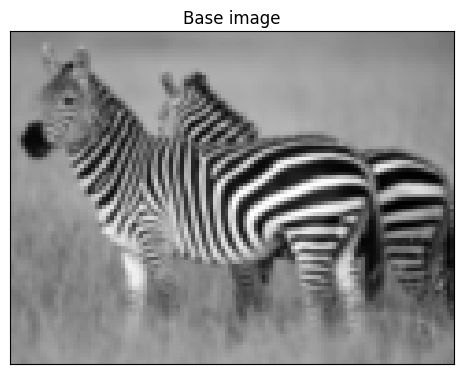

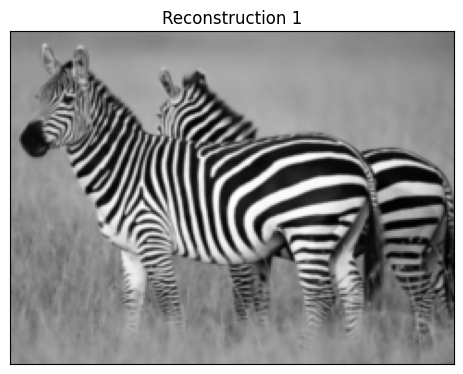

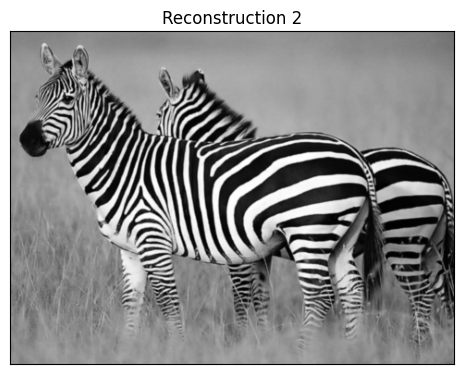

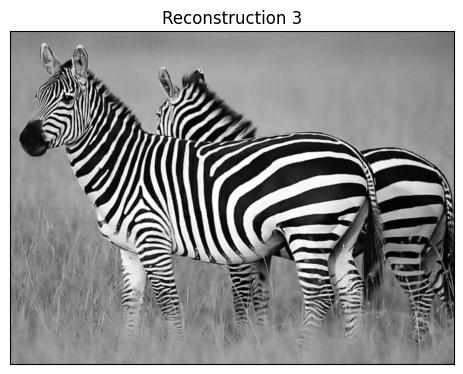

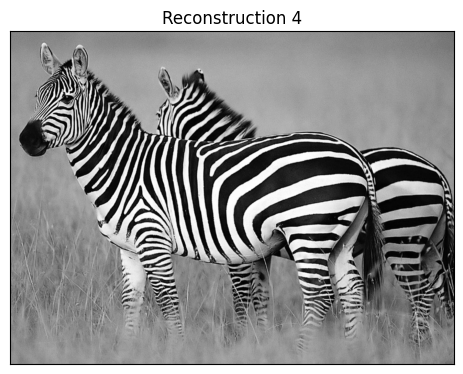

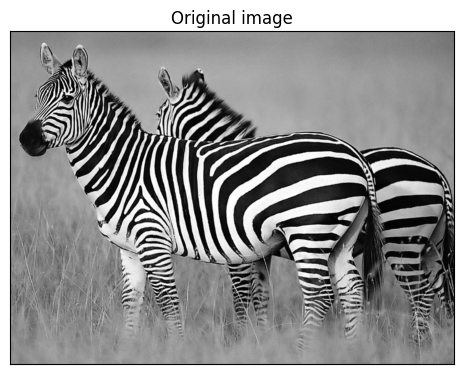

In [80]:
displayMI_ES([reconstructions[0]], factor = 0.9, title='Base image')
displayMI_ES([reconstructions[1]], factor = 0.9, title='Reconstruction 1')
displayMI_ES([reconstructions[2]], factor = 0.9, title='Reconstruction 2')
displayMI_ES([reconstructions[3]], factor = 0.9, title='Reconstruction 3')
displayMI_ES([reconstructions[4]], factor = 0.9, title='Reconstruction 4')
displayMI_ES([im], factor = 0.9, title='Original image')

Visualmente, comprobamos que la última reconstrucción es igual que la imagen original. Podemos comprobarlo calculando el RMSE entre las dos imágenes:

In [81]:
print('Error per pixel',np.sqrt(np.mean((im - reconstructions[4]) ** 2)))

Error per pixel 1.4078632574944977e-15


Obtenemos un error prácticamente igual a 0, comprobando que la reconstrucción es prácticamente perfecta.

De hecho, si redondeamos el valor de los píxeles de la imagen reconstruida, el error es completamente 0.

In [82]:
print('Error per pixel',np.sqrt(np.mean((im - np.round(reconstructions[4])) ** 2)))

Error per pixel 0.0


Podemos comprobar que, incluso con otro tamaño de kernel, la reconstrucción sigue siendo perfecta:

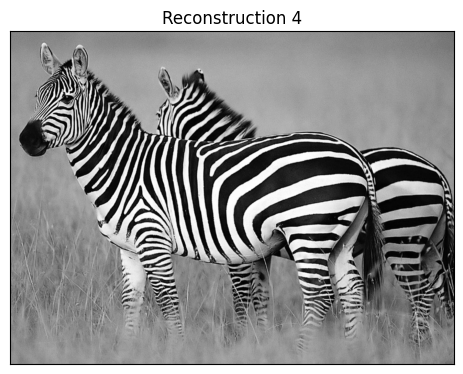

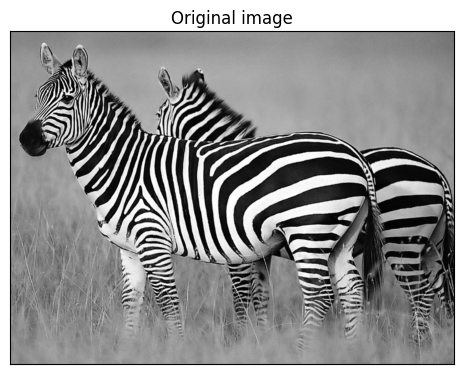

Error per pixel 0.0


In [83]:
pyrL = pyramidLap(im,sizeMask=31, nlevel=4)
reconstructions = reconstructLap(pyrL)

displayMI_ES([reconstructions[4]], factor = 0.9, title='Reconstruction 4')
displayMI_ES([im], factor = 0.9, title='Original image')

print('Error per pixel',np.sqrt(np.mean((im - np.round(reconstructions[4])) ** 2)))

Cabe destacar que, incluso en el apartado C, a pesar del ruido de las imágenes obtenidas, seguiría siendo posible una reconstrucción perfecta de la imagen original usando las imágenes de la pirámide laplaciana.

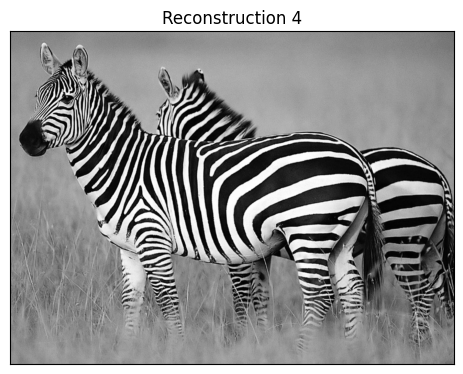

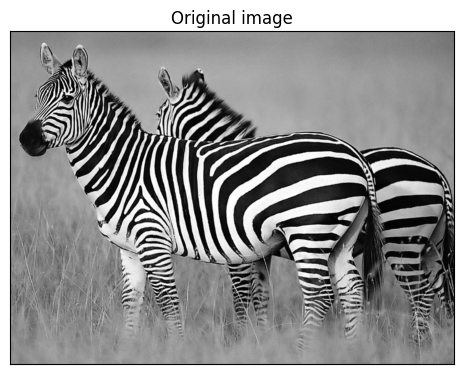

Error per pixel 0.0


In [84]:
pyrLNoSmooth = pyramidLap(im,sizeMask=7, nlevel=4, smooth=False)
reconstructions = reconstructLap(pyrLNoSmooth)

displayMI_ES([reconstructions[4]], factor = 0.9, title='Reconstruction 4')
displayMI_ES([im], factor = 0.9, title='Original image')

print('Error per pixel',np.sqrt(np.mean((im - np.round(reconstructions[4])) ** 2)))

Resulta en parte sorprendente que se pueda reconstruir las imágenes únicamente utilizando la pirámide laplaciana. Aunque puede parecer que la pirámide únicamente almacena las altas frecuencias de la imagen y la imagen original a escala reducida, este apartado demuestra que realmente contiene toda la información de la imagen.

Teóricamente, es el teorema de Nyquist-Shannon el que permite esta reconstrucción. El teorema nos dice que tras suavizar, aparecen píxeles con información redundante. La pirámide laplaciana, con una versión reducida de la imagen original, y los detalles (altas frecuencias) a varias escalas permite la reconstrucción.

Comprobamos en el apartado A que únicamente con la imagen original a escala reducida, no podíamos reconstruir la imagen original. La pirámide laplaciana nos proporciona las imágenes y detalles adicionales que necesitamos para conseguirlo.

# **Ejercicio 3: Imágenes Híbridas** (1.5 puntos)

<font color='blue'> Este ejercicio se basa en el siguiente trabajo: $\textit{Oliva, A., Torralba, A., & Schyns, P. G. (2006). Hybrid images. ACM Transactions on Graphics (TOG), 25(3), 527-532}$ (https://stanford.edu/class/ee367/reading/OlivaTorralb_Hybrid_Siggraph06.pdf). Vamos a aprender cómo el sistema visual humano extrae información sobre un objeto en función de la distancia. Para ello, construimos una imagen híbrida a partir de dos imágenes de objetos diferentes. Mezclando adecuadamente parte de las altas frecuencias de una imagen con parte de las bajas frecuencias de otra imagen, obtenemos una imagen híbrida que muestra diferentes percepciones con la distancia. El sigma empleado para filtrar ambas imágenes (tanto la de alta como la de bajas frecuencias) es el aspecto clave para seleccionar el rango de frecuencias altas y bajas de cada imagen. Cuanto mayor sea el valor sigma, mayor será la eliminación de altas frecuencias de la imagen. Se recomienda elegir este valor por separado para cada una de las imágenes y, de hecho, seguramente sea posible (y deseable) el tener distintos valores para distintos pares de imágenes.

<font color='blue'> Aspectos de importancia en relación a este ejercicio:

1. Como mínimo, se deben generar las imágenes híbridas correspondientes a `'cat.bmp'+'dog.bmp'`, `'submarine.bmp'+'fish.bmp'` y `'marilyn.bmp'+'einstein.bmp'` (todas ellas en escala de grises). Se debe emplear una pirámide Gaussiana con 5 niveles para mostrar el efecto obtenido.
2. No es necesario seguir al pie de la letra el artículo de referencia y operar en el dominio de la frecuencia (Fourier). Basta con operar en el dominio del espacio, como hemos hecho en todos los demás apartados de esta práctica.
3. Se debe explicar con claridad el criterio empleado para escoger la imagen de altas y la imagen de bajas frecuencias, así como el proceso seguido para filtrar la imagen de altas frecuencias y la de bajas frecuencias (incluyendo la elección de los sigmas finalmente utilizados; es decir, no sería suficiente indicar sucintamente que "se procedió por medio de prueba y error hasta obtener el sigma final").

Leemos las primeras dos imágenes:

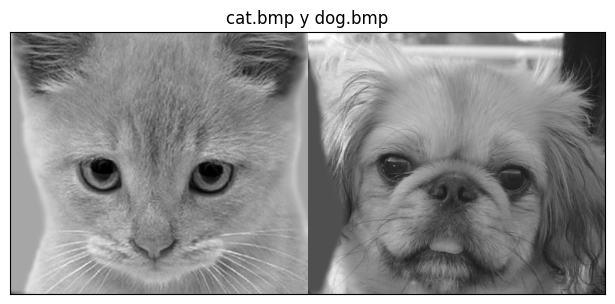

In [85]:
im_cat = cv2.imread(get_image('cat.bmp'),0).astype('float64')
im_dog = cv2.imread(get_image('dog.bmp'),0).astype('float64')

displayMI_ES([im_cat, im_dog], factor = 1.2, title='cat.bmp y dog.bmp')

En general, se recomienda elegir la imagen con mayor número de altas frecuencias como la imagen con la que nos quedaremos con sus detalles. Asimismo, se suele elegir la imagen con más bajas frecuencias como la imagen que suavizaremos.

La imagen que, a primera vista, tiene los bordes más acentuados es la imagen del perro. Podemos comprobar que el cortorno del gato está bastante suavizado, mientras que el contorno de los pelos del perro está bastante marcado.

Por tanto, elegiremos como imagen de altas frecuencias la del perro y como imagen de bajas frecuencias la del gato.

Nuestro objetivo será ahora suavizar la imagen del gato hasta obtener una imagen en la que únicamente sea visible una pequeña parte de la imagen. Para ello, suavizaremos la imagen utilizando varios sigmas (se han utilizado un mayor número de sigmas en la experimentación, pero a modo ilustrativo utilizaremos únicamente 3):

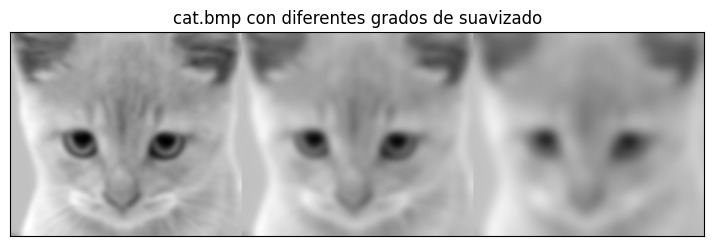

In [86]:
sigmas_smooth = [4.0, 6.0, 10.0]
cat_imgs_smoothed = []

for sigma in sigmas_smooth:
  cat_imgs_smoothed.append(my2DConv(im_cat,sigma,[0,0]))

displayMI_ES(cat_imgs_smoothed, factor = 1.4, title='cat.bmp con diferentes grados de suavizado')

Como vemos, a mayor valor de `sigma`, mayor será el suavizado y menos detalle se podrán ver los detalles de la imagen.

Intentaremos ahora quedarnos únicamente con los detalles de la imagen del perro. Para ello, calcularemos la diferencia de la imagen original con una versión suavizada suya.

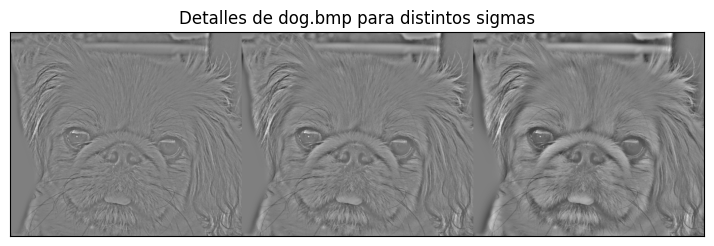

In [87]:
sigmas_details = [4.0, 6.0, 10.0]
dog_imgs_details = []

for sigma in sigmas_details:
  dog_imgs_details.append(im_dog - my2DConv(im_dog,sigma,[0,0]))

displayMI_ES(dog_imgs_details, factor = 1.4, title='Detalles de dog.bmp para distintos sigmas')

En este caso, a mayor sigma, más resaltados estarán los detalles y mejor se podrán ver los bordes de la imagen.

Deberemos ahora sumar una imagen del gato de las obtenidas en el suavizado y una del perro de las obtenidas en la anterior celda. Veamos algunas posibilidades. Por ejemplo, probemos a sumar las imágenes con menores sigmas del gato con las de menor sigma del perro, y las imágenes con mayores sigmas del gato con las de mayor sigma del perro:

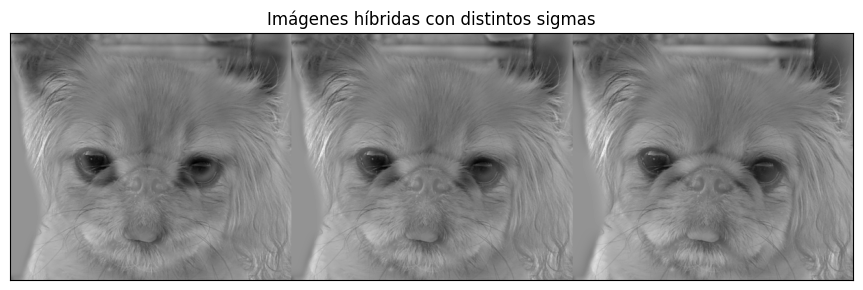

In [88]:
hybrid_images = []

for i in range(len(dog_imgs_details)):
  hybrid_images.append(dog_imgs_details[i] + cat_imgs_smoothed[i])

displayMI_ES(hybrid_images, factor = 1.7, title='Imágenes híbridas con distintos sigmas')

A distancias cortas, predominarán los detalles de la imagen (es decir, predominarán las altas frecuencias), mientras que a largas distancias se pierden los detalles y predominan las bajas frecuencias.

Por tanto, a distancias cortas debería predominar la imagen del perro (altas frecuencias).

En la primera de las imágenes se sigue viendo el gato, por lo que podemos rápidamente descartar dicha combinación. Sin embargo, tanto en la segunda como en la tercera imagen, solo se puede apreciar el perro, por lo que podríamos continuar con dichas combinaciones.

Para comprobar si realmente son interesantes estas combinaciones, mostramos su pirámide gaussiana para simular que nos alejamos de la imagen. Si en las imágenes más pequeñas podemos observar el gato, tendremos una imagen realmente híbrida.

Para la visualización de la pirámide gaussiana, consideraremos un tamaño de máscara de 7, que es el valor que se ha estado usando en los anteriores apartados. Se trata de un valor que no es ni muy elevado, lo que provocaría imágenes demasiado suavizadas, ni demasiado reducido, lo que podría provocar ruido. Para que no provoque diferencias en la visualización, se utilizará este valor durante todo el ejercicio.

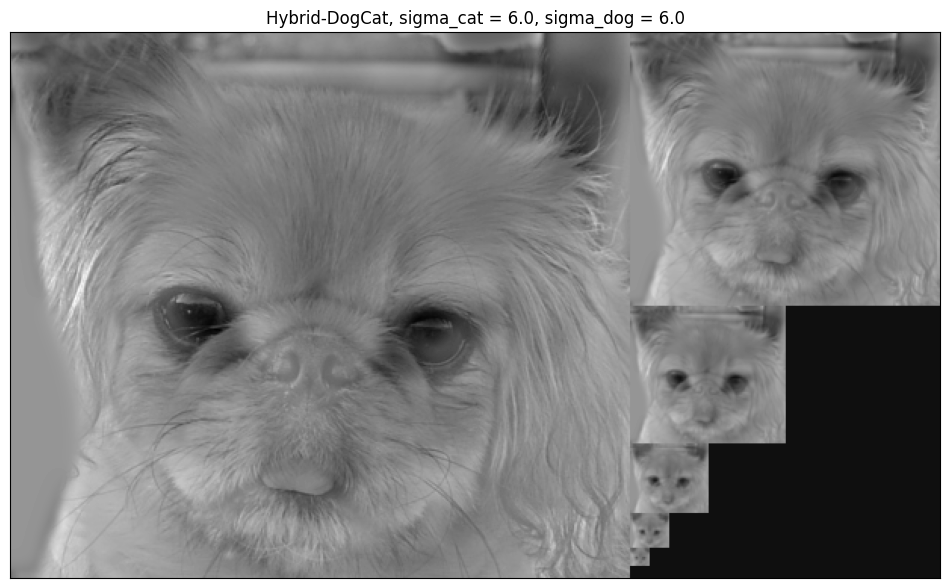

In [89]:
plt.figure(figsize=(6, 4))
pyrG = pyramidGauss(hybrid_images[1],sizeMask = 7, nlevel=5)
displayPyramid(pyrG,f'Hybrid-DogCat, sigma_cat = {sigmas_smooth[1]}, sigma_dog = {sigmas_details[1]}')

En las primeras imágenes podemos observar únicamente al perro, mientras que en las imágenes más pequeñas observamos únicamente al gato, por lo que tenemos una imagen realmente híbrida. Podemos comprobar si utilizando la combinación que obtuvimos anteriormente para ver si el resultado es mejor o peor:

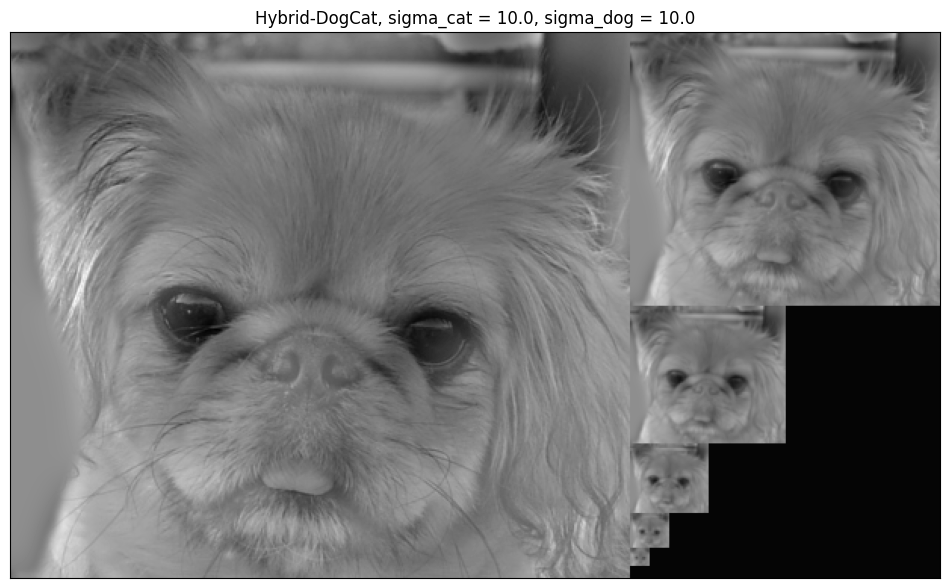

In [90]:
plt.figure(figsize=(6, 4))
pyrG = pyramidGauss(hybrid_images[2],sizeMask = 7, nlevel=5)
displayPyramid(pyrG,f'Hybrid-DogCat, sigma_cat = {sigmas_smooth[2]}, sigma_dog = {sigmas_details[2]}')

En este caso, el resultado es peor, ya que resulta bastante más complicado ver al gato en las imágenes más pequeñas. Únicamente en los dos últimos niveles se observa el gato, por lo que nos quedamos con los sigmas obtenidos anteriormente, es decir, $\sigma_{cat} = 6$ y $\sigma_{dog} = 6$.

El proceso que se realizará para las dos imágenes restantes será análogo.

Elegiremos la imagen de altas frecuencias y la de bajas frecuencias:

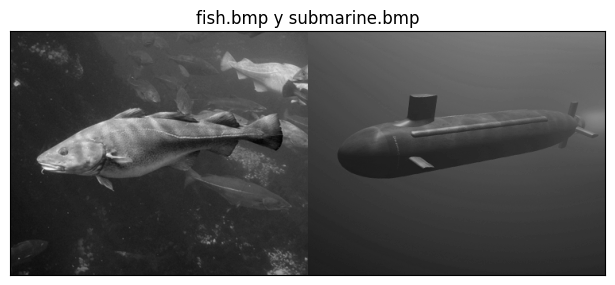

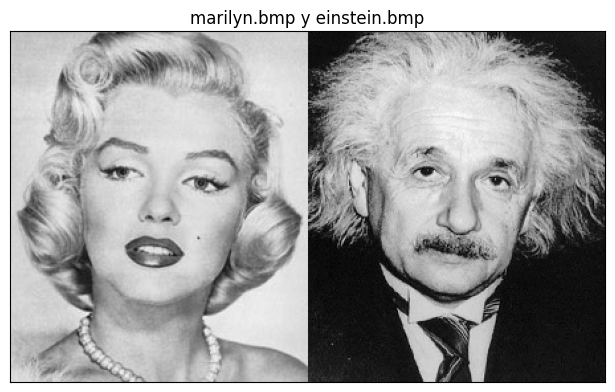

In [91]:
im_fish = cv2.imread(get_image('fish.bmp'),0).astype('float64')
im_submarine = cv2.imread(get_image('submarine.bmp'),0).astype('float64')

displayMI_ES([im_fish, im_submarine], factor = 1.2, title='fish.bmp y submarine.bmp')

im_marilyn = cv2.imread(get_image('marilyn.bmp'),0).astype('float64')
im_einstein = cv2.imread(get_image('einstein.bmp'),0).astype('float64')

displayMI_ES([im_marilyn, im_einstein], factor = 1.2, title='marilyn.bmp y einstein.bmp')

En cuanto a las dos primera imágenes: podemos observar que la imagen de los peces tiene muchos detalles, la silueta de los peces, las aletas, el ojo... Por otra parte, la imagen del submarino es muy suave, tanto los bordes como el fondo. De hecho, parece que se trata de una imagen sintética.

Elegimos, por tanto, el submarino, como imagen de bajas frecuencias, y la imagen del pez como imagen de altas frecuencias.

Procedemos de forma similar con las otras dos imágenes: la imagen de Einstein, especialmente en el caso de los pelos o la nariz, es una imagen con muchas altas frecuencias. Por otra parte, la imagen de Marilyn Monroe es bastante más suave, con bordes menos acentuados.

Elegimos, por tanto, la imagen de Marilyn como imagen de bajas frecuencias, y la imagen de Einstein como imagen de altas frecuencias.

Consideramos ahora varios sigmas (utilizaremos varios valores, en los más pequeños la imagen no estará muy borrosa, y en los valores más grandes, la imagen será casi totalmente sin detalles) para el suavizado de los dos conjuntos de imágenes:

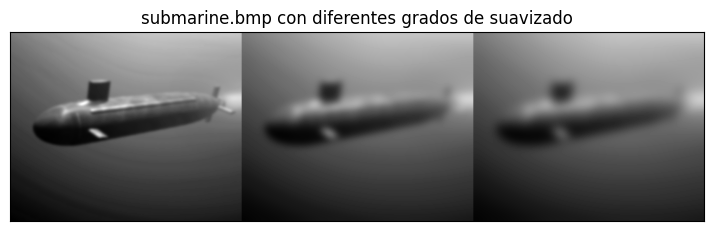

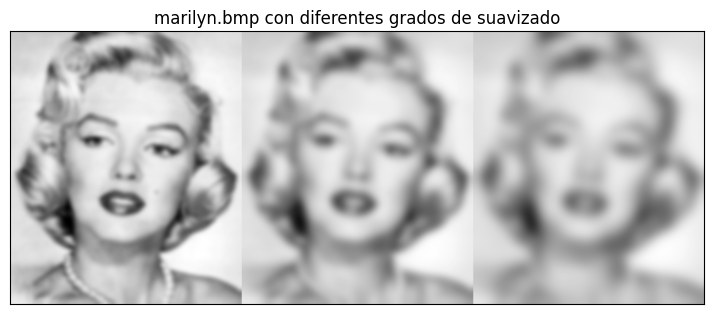

In [92]:
# SUBMARINO
sigmas_smooth1 = [2.0, 6.0, 8.0]
submarine_imgs_smoothed = []

for sigma in sigmas_smooth1:
  submarine_imgs_smoothed.append(my2DConv(im_submarine,sigma,[0,0]))

displayMI_ES(submarine_imgs_smoothed, factor = 1.4, title='submarine.bmp con diferentes grados de suavizado')

# MARYLIN
sigmas_smooth2 = [2.0, 4.0, 6.0]
marilyn_imgs_smoothed = []

for sigma in sigmas_smooth2:
  marilyn_imgs_smoothed.append(my2DConv(im_marilyn,sigma,[0,0]))

displayMI_ES(marilyn_imgs_smoothed, factor = 1.4, title='marilyn.bmp con diferentes grados de suavizado')

Consideramos ahora varios sigmas (valores más pequeños con detalles poco acentuados, y en los valores más grandes, detalles muy exagerados) para destacar los detalles de los dos conjuntos de imágenes:

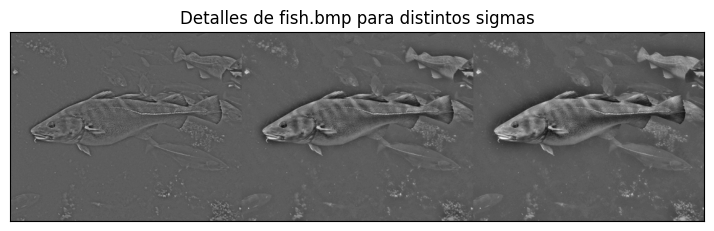

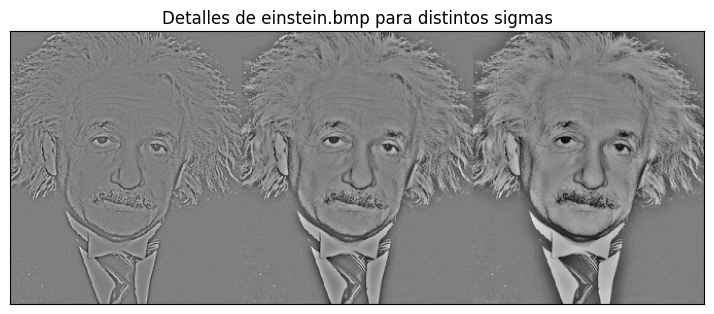

In [93]:
# PECES
sigmas_details1 = [3.0, 7.0, 13.0]
fish_imgs_details = []

for sigma in sigmas_details1:
  fish_imgs_details.append(im_fish - my2DConv(im_fish,sigma,[0,0]))

displayMI_ES(fish_imgs_details, factor = 1.4, title='Detalles de fish.bmp para distintos sigmas')

# EINSTEIN
sigmas_details2 = [2.0, 4.0, 8.0]
einstein_imgs_details = []

for sigma in sigmas_details2:
  einstein_imgs_details.append(im_einstein - my2DConv(im_einstein,sigma,[0,0]))

displayMI_ES(einstein_imgs_details, factor = 1.4, title='Detalles de einstein.bmp para distintos sigmas')

Creamos ahora algunas imágenes híbridas para comprobar qué sigmas podemos elegir:

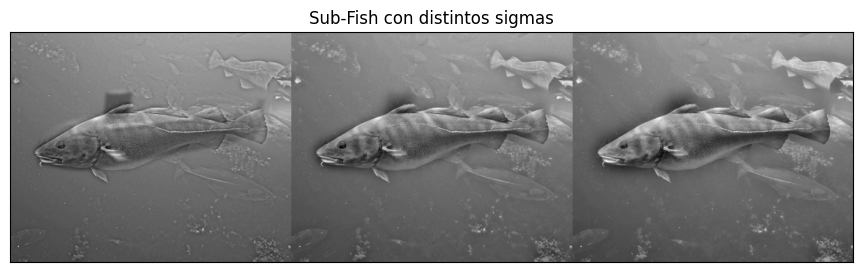

In [94]:
hybrid_images1 = []

for i in range(len(fish_imgs_details)):
  hybrid_images1.append(submarine_imgs_smoothed[i] + fish_imgs_details[i])

displayMI_ES(hybrid_images1, factor = 1.7, title='Sub-Fish con distintos sigmas')

En el primero de los casos, se puede apreciar bastante el submarino, por lo que nos quedamos mejor con el segundo y tercer valor.

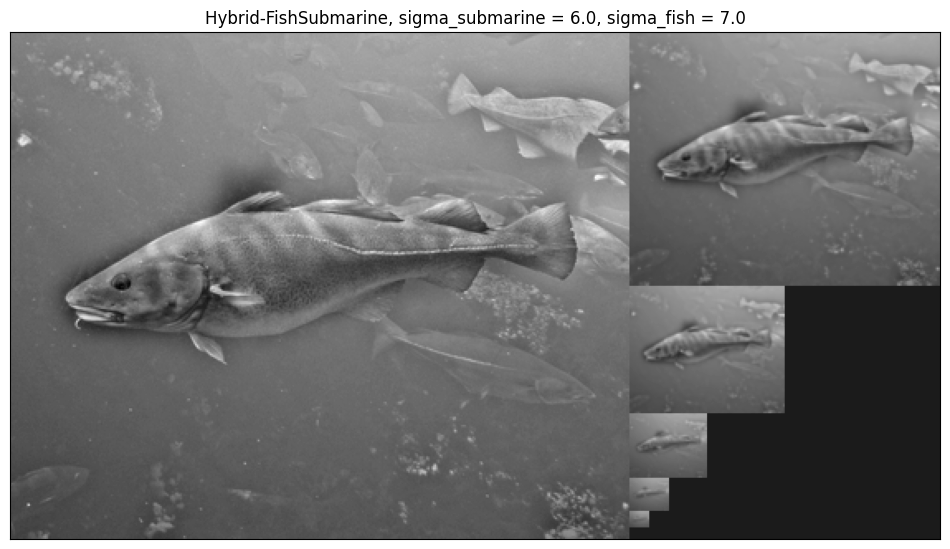

In [95]:
plt.figure(figsize=(6, 4))
pyrG = pyramidGauss(hybrid_images1[1],sizeMask = 7, nlevel=5)
displayPyramid(pyrG,f'Hybrid-FishSubmarine, sigma_submarine = {sigmas_smooth1[1]}, sigma_fish = {sigmas_details1[1]}')

El resultado usando esta segunda opción ($\sigma_{submarine}=6$ y $\sigma_{fish}=7$) es bastante bueno, observándose el submarino en los tres últimos niveles.

A pesar de ello, es importante destacar que estas imágenes son bastantes más distintas entre ellas que la del perro y el gato, y por ello, el resultado no llega a ser tan bueno como el anterior.

Finalizamos ya por último con las imágenes de Einstein y Marilyn. Mostramos primero algunas imágenes híbridas que obtenemos:

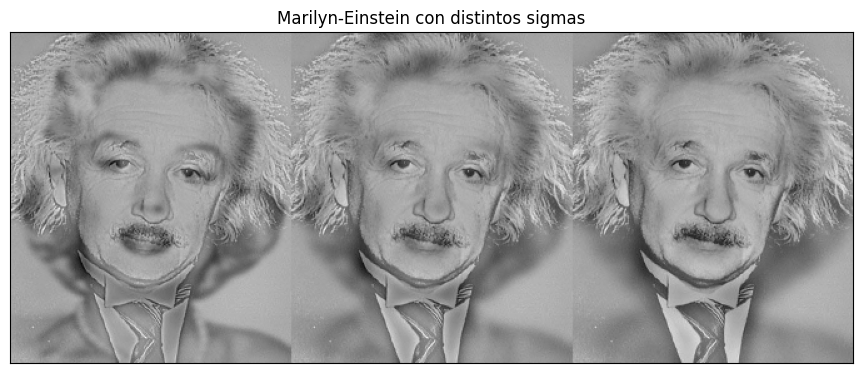

In [96]:
hybrid_images2 = []

for i in range(len(einstein_imgs_details)):
  hybrid_images2.append(marilyn_imgs_smoothed[i] + einstein_imgs_details[i])

displayMI_ES(hybrid_images2, factor = 1.7, title='Marilyn-Einstein con distintos sigmas')

De nuevo, en el primer caso, aun es visible la cara de Marilyn. Probamos si con el siguiente valor de sigma se obtiene un buen resultado:

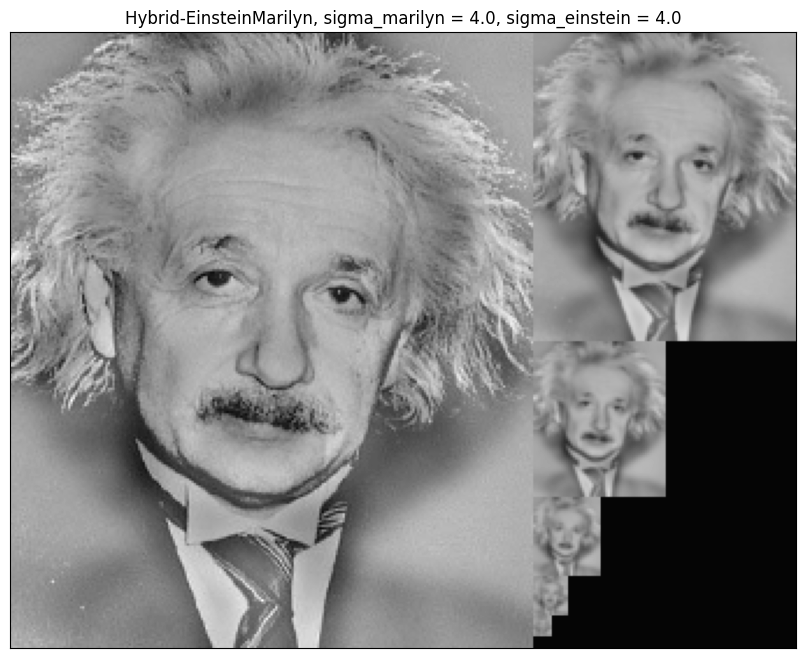

In [97]:
plt.figure(figsize=(6, 4))
pyrG = pyramidGauss(hybrid_images2[2],sizeMask = 7, nlevel=5)
displayPyramid(pyrG,f'Hybrid-EinsteinMarilyn, sigma_marilyn = {sigmas_smooth2[1]}, sigma_einstein = {sigmas_details2[1]}')

, y el resultado no es satisfactorio, ya que no observamos prácticamente a Marilyn en las últimas imágenes. Por ello, deberíamos suavizar algo menos la imagen de Marilyn (disminuir sigma), o bien destacar menos detalles de la cara de Einstein (disminuyendo el sigma al quedarnos con los detalles).

Decrementemos primero el sigma asociado a la imagen de Marilyn, a ver si obtenemos un mejor resultado:

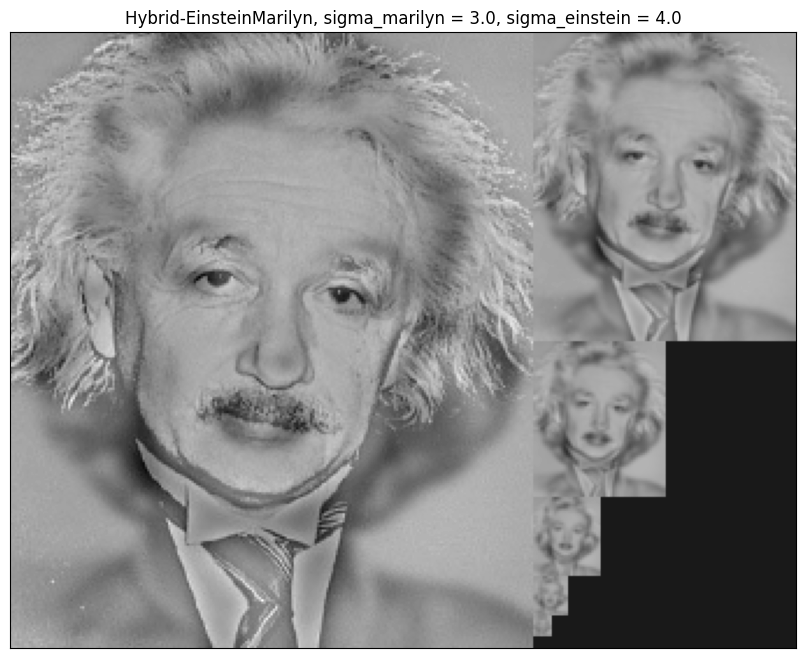

In [98]:
sigma_marilyn = 3.0
sigma_einstein = 4.0

smooth_image = my2DConv(im_marilyn,sigma_marilyn,[0,0])
detail_image = im_einstein - my2DConv(im_einstein,sigma_einstein,[0,0])
hybrid_image = smooth_image + detail_image

plt.figure(figsize=(6, 4))
pyrG = pyramidGauss(hybrid_image,sizeMask = 7, nlevel=5)
displayPyramid(pyrG,f'Hybrid-EinsteinMarilyn, sigma_marilyn = {sigma_marilyn}, sigma_einstein = {sigma_einstein}')

Obtenemos un resultado mucho más satisfactorio. En este caso, sí podemos observar a Einstein en las imágenes de mayor tamaño y a Marilyn en las de menor tamaño. Por lo que nos quedaríamos con dichos valores de sigma: $\sigma_{Einstein} = 4.0$ y $\sigma_{Marilyn}=3.0$

# **Ejercicio 4: Pyramid Blending** (1 punto)

<font color='blue'> En este ejercicio se debe crear la imagen fusionada de la manzana (`apple.jpg`; parte superior de la imagen fusionada final) y la naranja (`orange.jpg`; parte inferior de la imagen fusionada final) empleando la técnica de $\textit{Pyramid Blending}$. Para este ejercicio, si se desea, sí se pueden emplear las funciones de OpenCV `pyrDown` y `pyrUp`.

<font color='blue'> Se debe:
1. explicar en detalle el proceso seguido a la hora de crear la nueva imagen (mezcla de ambas);
2. comparar el resultado con la combinación de las imágenes sin emplear _blending_, es decir, juntando directamente los píxeles de la mitad superior de una imagen con la mitad inferior de la otra;
3. mostrar los estados intermedios del procesado. Es decir, las pirámides Gaussianas calculadas para cada imagen (5 niveles cada una), las pirámides Laplacianas correspondientes, y los distintos niveles en que se va mezclando la imagen de salida (es decir, la reconstrucción en el nivel 1, la reconstrucción en el nivel 2,... y así sucesivamente hasta mostrar la imagen final reconstruida/_blended_).  



Leeremos primero dos imágenes a color, para ello dejamos de incluir el parámetro 0 que estábamos utilizando en `cv2.imread`:

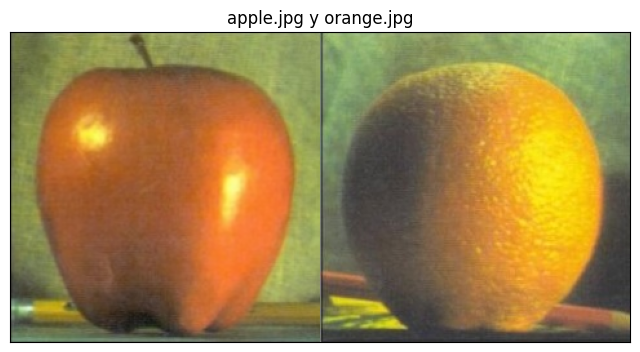

In [99]:
im_apple = cv2.imread(get_image('apple.jpg'))            # read image
im_orange = cv2.imread(get_image('orange.jpg'))

im_apple = cv2.cvtColor(im_apple, cv2.COLOR_BGR2RGB)        # order channels as RGB
im_orange = cv2.cvtColor(im_orange, cv2.COLOR_BGR2RGB)        # order channels as RGB

# La imagen de orange.jpg no tiene el mismo tamaño que la de apple.jpg!
im_apple = cv2.resize(im_apple, dsize=im_orange.shape[:-1][::-1])

im_apple = im_apple / 255                              # values range from 0 to 1
im_orange = im_orange / 255

plt.figure(figsize=(4, 4))
displayMI_ES([im_apple,im_orange], 'apple.jpg y orange.jpg')

Deberemos ahora calcular la pirámide laplaciana de cada una de las dos imágenes. Para ello, podemos usar la función implementada en el ejercicio 2, o bien las funciones de OpenCV `pyrUp` y `pyrDown`.

Obviamente, para el cálculo de la pirámide laplaciana se calcularán previamente las pirámides gaussianas de cada imagen.

En cuanto al número de niveles de la pirámide laplaciana que utilizaremos se considerarán los suficientes como para que el resultado sea satisfactorio, es decir, para que el pegado sea bastante suave. Comenzaremos utilizando 4, y si es necesario, tras ver los resultados, aumentaríamos dicho número.

Optaremos por hacerlo con la implementación de OpenCV, para facilitar la implementación con imágenes a color.

In [100]:
nlevels = 4

Adaptamos la función de mostrar la pirámide para que sea compatible con imágenes RGB:

In [101]:
def displayPyramidRGB(vim, title='result'):
    temp = np.zeros_like(vim[0])
    if np.mod(temp.shape[1], 2) == 0:
        h = temp[:, :temp.shape[1]//2, :]  # Mantiene la mitad de la imagen para la última fila
    else:
        h = temp[:, :(temp.shape[1]//2) + 1, :]

    # Concatenación horizontal para acomodar los niveles de la pirámide
    out = np.hstack((temp, h))
    top = 0
    out[0:vim[0].shape[0], 0:vim[0].shape[1], :] = vim[0]
    left = vim[0].shape[1]

    for i in range(1, len(vim)):
        out[top:top+vim[i].shape[0], left:left + vim[i].shape[1], :] = vim[i]
        top += vim[i].shape[0]

    displayIm(out, title)  # Supone que displayIm puede manejar imágenes RGB

Calculamos las pirámides gaussianas de ambas imágenes:

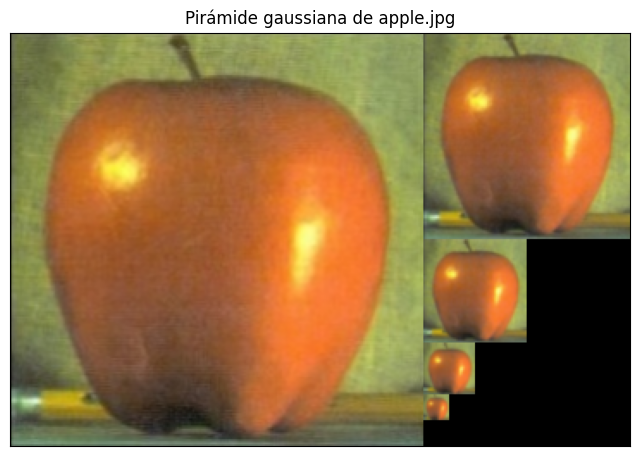

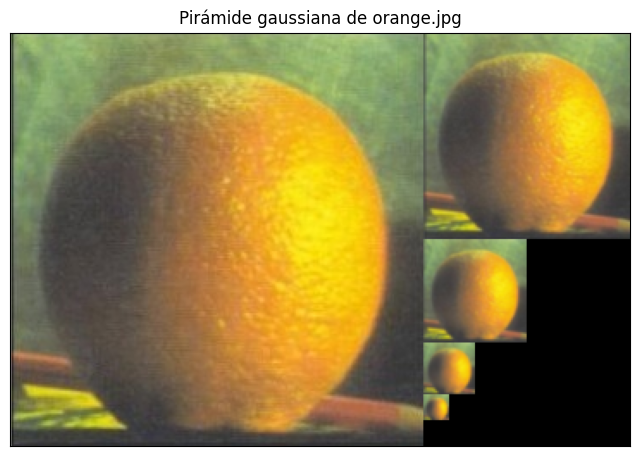

In [102]:
# PIRÁMIDE GAUSSIANA DE LA MANZANA
pyrGapple = [im_apple]

for i in range(nlevels):
  pyrGapple.append(cv2.pyrDown(pyrGapple[-1]))

plt.figure(figsize=(4, 4))
displayPyramidRGB(pyrGapple, title='Pirámide gaussiana de apple.jpg')


# PIRÁMIDE GAUSSIANA DE LA NARANJA
pyrGorange = [im_orange]

for i in range(nlevels):
  pyrGorange.append(cv2.pyrDown(pyrGorange[-1]))

plt.figure(figsize=(4, 4))
displayPyramidRGB(pyrGorange, title='Pirámide gaussiana de orange.jpg')

y ahora construimos las pirámides laplacianas:

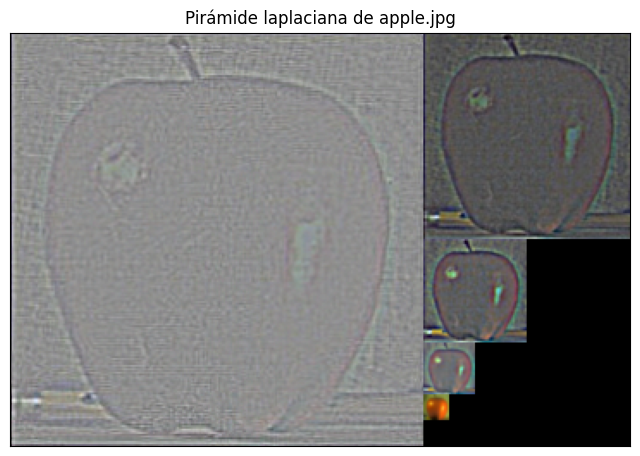

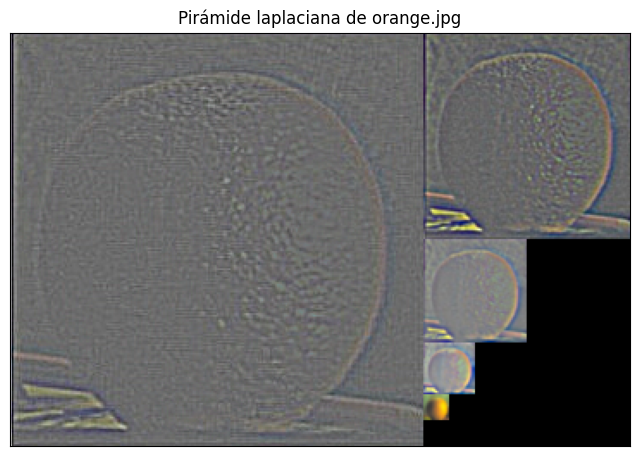

In [103]:
# PIRÁMIDE LAPLACIANA DE LA MANZANA
pyrLapple = [pyrGapple[-1]]

for i in range(nlevels-1,-1,-1):
  pyrLapple.append(pyrGapple[i] - cv2.pyrUp(pyrGapple[i+1]))

plt.figure(figsize=(4, 4))
pyrLapple.reverse()

# Visualización (entre 0 y 1)
pyrLapple01 = []

for level in pyrLapple:
  pyrLapple01.append(rangeDisplay01(level,True))

displayPyramidRGB(pyrLapple01, title='Pirámide laplaciana de apple.jpg')

# PIRÁMIDE LAPLACIANA DE LA NARANJA
pyrLorange = [pyrGorange[-1]]

for i in range(nlevels-1,-1,-1):
  pyrLorange.append(pyrGorange[i] - cv2.pyrUp(pyrGorange[i+1]))

plt.figure(figsize=(4, 4))
pyrLorange.reverse()

# Visualización (entre 0 y 1)
pyrLorange01 = []

for level in pyrLorange:
  pyrLorange01.append(rangeDisplay01(level,True))

displayPyramidRGB(pyrLorange01, title='Pirámide laplaciana de orange.jpg')

Construiremos ahora la máscara para realizar la fusión. Para saber cómo construir la máscara, debemos saber la función que tiene.

Tras construir la máscara, calcularemos la pirámide laplaciana de la nueva "imagen sintética", utilizando lo siguiente:

$$
L(i,j) = G(i,j)L_{apple}(i,j) + (1-G(i,j))L_{orange}(i,j)
$$

, donde $G$ es la pirámide gaussiana de la máscara y $L_{apple}$ y $L_{orange}$ son las pirámides laplacianas de la imagen de la manzana y de la naranja, respectivamente.

Queremos que la parte superior de la imagen sea de la manzana, y la parte inferior de la naranja. Por tanto, si $i,j$ están en la parte superior de la imagen deberíamos tener $L(i,j) = L_{apple}(i,j)$ y si $i,j$ están en la parte inferior de la imagen deberíamos tener $L(i,j) = L_{orange}(i,j)$.

Por tanto, la máscara deberá tener 1 en la mitad superior (blanco) y 0 en la mitad inferior (negro).

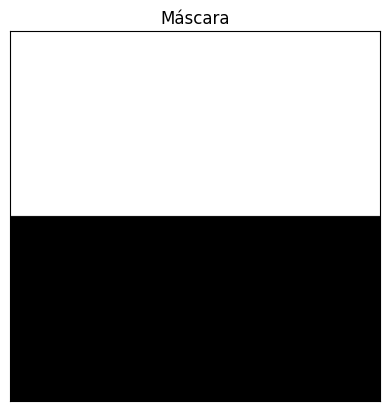

In [104]:
half_height = int(im_apple.shape[0] / 2)

im_mask = np.zeros_like(im_apple)

for row in range(half_height):
  im_mask[row, :, :] = 1.0

displayMI_ES([im_mask], 'Máscara', factor = 1.0)

Para conseguir un resultado incluso mejor, podemos suavizar la imagen de la máscara mediante un filtro gaussiano. Utilizaremos la función de OpenCV `GaussianBlur` (se podría también utilizar nuestra implementación, pero sería necesario realizarlo en cada uno de los tres canales de la imagen). Utilizaremos un sigma suficientemente elevado como para que sea notable el efecto del suavizado:

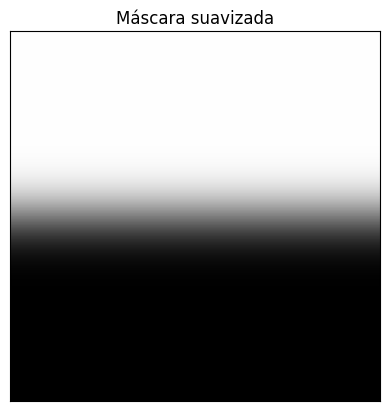

In [105]:
im_mask_smooth = cv2.GaussianBlur(im_mask, ksize= (0,0), sigmaX = 17.0, sigmaY = 17.0)
displayMI_ES([im_mask_smooth], 'Máscara suavizada', factor = 1.0)

Construimos ahora la pirámide gaussiana de esta máscara. Construiremos también la de la máscara sin suavizar para comparar los resultados finales:

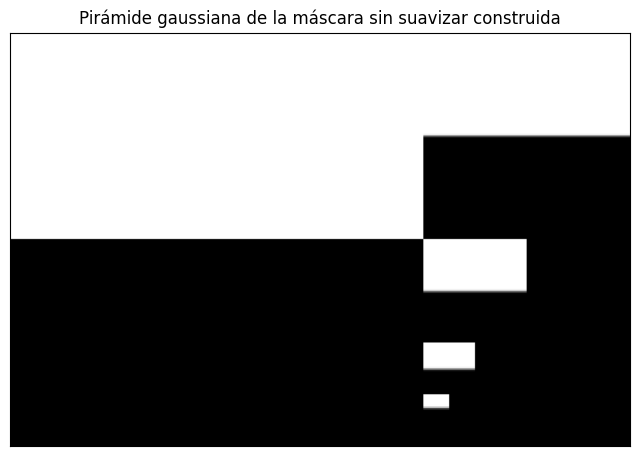

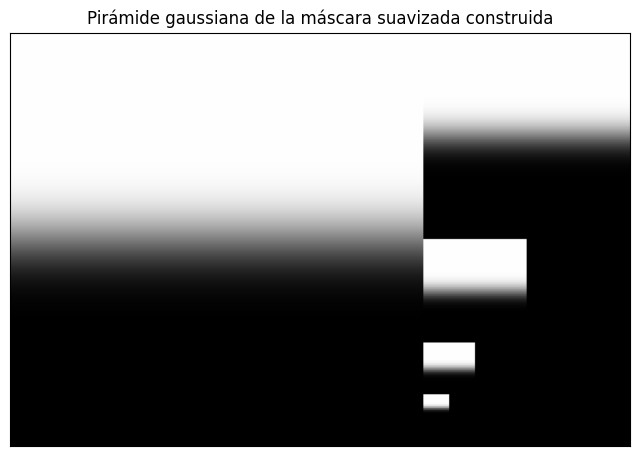

In [106]:
# PIRÁMIDE GAUSSIANA DE LA MÁSCARA SUAVIZADA
pyrGMask = [im_mask]

for i in range(nlevels):
  pyrGMask.append(cv2.pyrDown(pyrGMask[-1]))

plt.figure(figsize=(4, 4))
displayPyramidRGB(pyrGMask, title='Pirámide gaussiana de la máscara sin suavizar construida')


# PIRÁMIDE GAUSSIANA DE LA MÁSCARA SUAVIZADA
pyrGMaskSmooth = [im_mask_smooth]

for i in range(nlevels):
  pyrGMaskSmooth.append(cv2.pyrDown(pyrGMaskSmooth[-1]))

plt.figure(figsize=(4, 4))
displayPyramidRGB(pyrGMaskSmooth, title='Pirámide gaussiana de la máscara suavizada construida')


Finalmente utilizamos los pesos de la máscara, como anteriormente se ha explicado, para obtener la pirámide laplaciana de la nueva 'imagen sintética'.

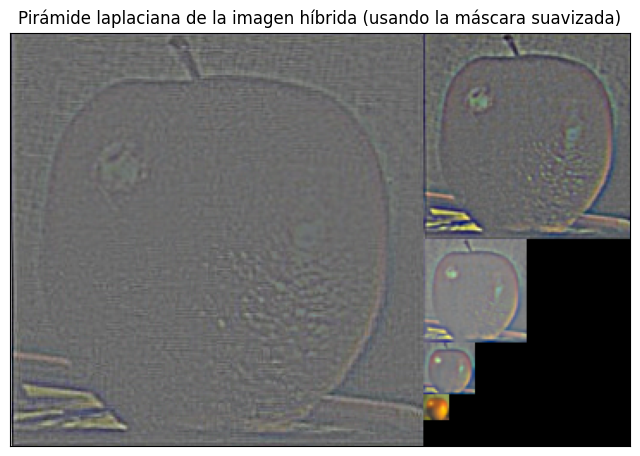

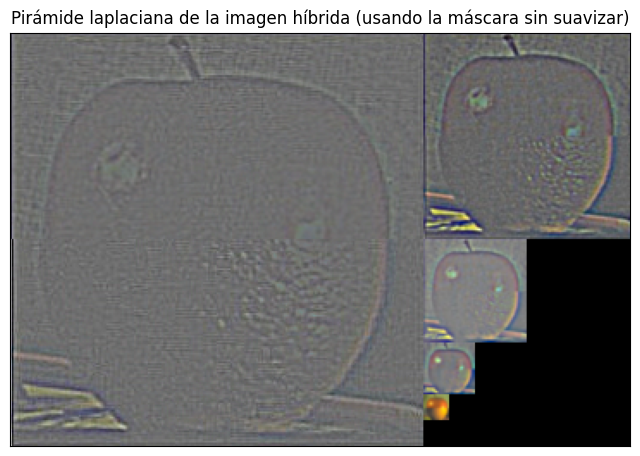

In [107]:
def buildBendPyramid(pyrMask, pyrA, pyrB):
  pyrLblend = []

  for i in range(len(pyrA)):
    pyrLblend.append(np.multiply(pyrMask[i], pyrA[i]) + np.multiply(1-pyrMask[i], pyrLorange[i]))

  return pyrLblend

def rangePyramid01(pyramid):
  pyr01 = []

  for level in pyramid:
    pyr01.append(rangeDisplay01(level,True))

  return pyr01

# Máscara con suavizado
pyrLBlendSmooth = buildBendPyramid(pyrGMaskSmooth, pyrLapple, pyrLorange)
pyrLBlendSmooth01 = rangePyramid01(pyrLBlendSmooth)

plt.figure(figsize=(4, 4))
displayPyramidRGB(pyrLBlendSmooth01, title='Pirámide laplaciana de la imagen híbrida (usando la máscara suavizada)')

# Máscara sin suavizar
pyrLBlend = buildBendPyramid(pyrGMask, pyrLapple, pyrLorange)
pyrLBlend01 = rangePyramid01(pyrLBlend)

plt.figure(figsize=(4, 4))
displayPyramidRGB(pyrLBlend01, title='Pirámide laplaciana de la imagen híbrida (usando la máscara sin suavizar)')

Ya incluso viendo las distintas etapas de la pirámide laplaciana, se observa que al usar la máscara sin suavizar aparece un corte en la mitad de la imagen que no se observa si se usa la máscara suavizada.

Únicamente nos quedaría reconstruir la nueva imagen a partir de la anterior pirámide laplaciana. Para ello, utilizamos el algoritmo explicado en el el ejercicio 2.D.

Mostramos las reconstrucciones en los distintos niveles, tanto para la máscara suavizada como sin suavizar:

In [108]:
a = [1,2,3]
a[0:2]

[1, 2]

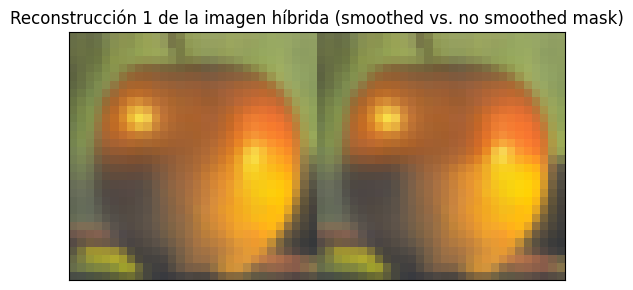

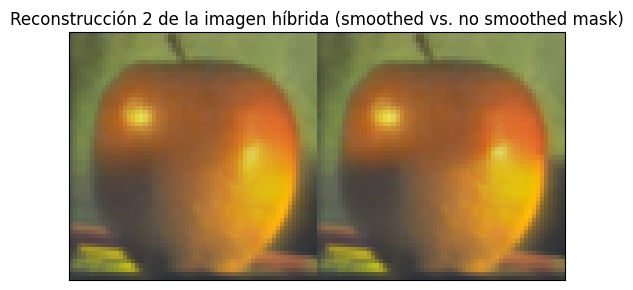

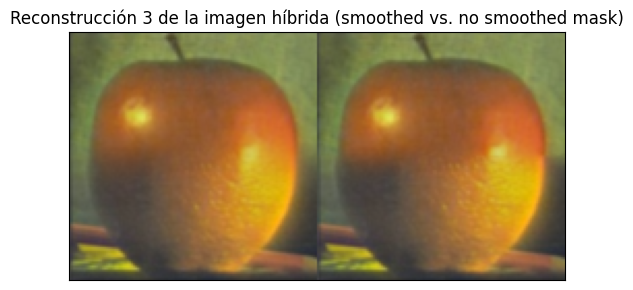

In [109]:
pyrLBlendSmooth.reverse()
reconstructionsSmooth = reconstructLap(pyrLBlendSmooth)

pyrLBlend.reverse()
reconstructions = reconstructLap(pyrLBlend)

for i in range(1, len(reconstructions)-1):
  displayMI_ES([reconstructionsSmooth[i], reconstructions[i]], f'Reconstrucción {i} de la imagen híbrida (smoothed vs. no smoothed mask)', factor = 1.0)

Como podemos comprobar, las reconstrucciones se van pareciendo cada vez más a una imagen híbrida.

Mostramos finalmente la reconstrucción final:

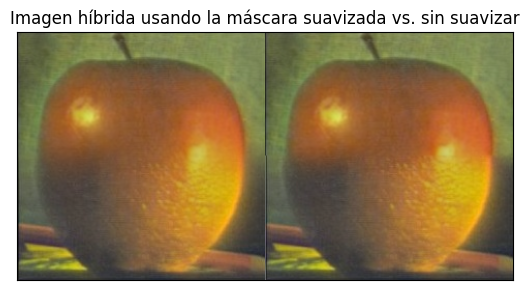

In [110]:
displayMI_ES([reconstructionsSmooth[-1], reconstructions[-1]], 'Imagen híbrida usando la máscara suavizada vs. sin suavizar', factor = 1.0)

Utilizando la máscara suavizada, se obtiene un resultado que llega incluso a ser sorprendente. La fusión entre ambas imágenes es perfecta, incluso en los efectos de iluminación también combinan perfectamente.

En el caso de la máscara sin suavizar, el resultado no es mucho peor, pero es cierto que se aprecia perfectamente que la ilumincación no es perfectamente, y se puede apreciar en cierta medida un corte horizontal en la imagen.

Podemos finalmente comparar el resulado con fusionar las dos imágenes directamente, tomando la mitad superior de la imagen de la manzana y la mitad inferior de la naranja y uniéndolas en una imagen directamente.

Para ello, usamos directamente la máscara que tenemos como pesos, multiplicándola por la imagen de la manzana y de la naranja.

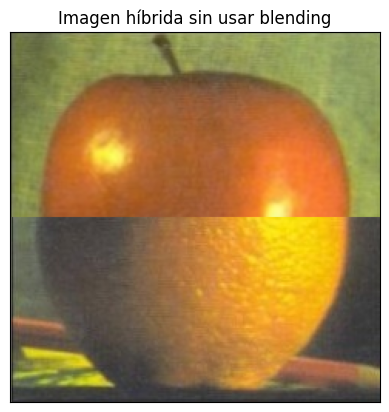

In [111]:
im_noblend = np.multiply(im_mask, im_apple) + np.multiply(1-im_mask, im_orange)
displayMI_ES([im_noblend], 'Imagen híbrida sin usar blending', factor = 1.0)

, y obtenemos, como esperábamos, un resultado lejos de lo obtenido usando `blending`.

Se observa un gran corte horizontal en mitad de la imagen, y se obtiene el efecto de que las imágenes han sido pegadas de forma artificial. Es por ello que cualquiera de los resultados anteriores, con o sin suavizado en la máscara, es mucho mejor que el obtenido de esta forma.

Comprobamos así la utilidad de realizar la mezcla utilizando las pirámides laplacianas, en lugar de realizarla directamente a la escala original.